In [2]:
import os
import tensorflow as tf
import random

from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

In [3]:
gtPath = "_conv3/"
rgbPath = "_out/"

modelList = ['Unet','DeepLab','Segnet','PspNet']

modelChoice = 'Segnet'

gtFileNames = os.listdir(gtPath)
outFileNames = os.listdir(rgbPath)

matchingFiles = set(outFileNames) & set(gtFileNames)

In [3]:
NumTrainingImages = 10000
StartingIndex = 0

import random

FileNames = random.sample(matchingFiles, NumTrainingImages)

                            
gtFileNames = gtFileNames[StartingIndex:StartingIndex+NumTrainingImages]
outFileNames = outFileNames [StartingIndex:StartingIndex+NumTrainingImages]

for i in range(0,NumTrainingImages):
    gtFileNames[i] = gtPath + FileNames[i]
    outFileNames[i] = rgbPath + FileNames[i]
    

C:\Users\danie\AppData\Local\Temp\ipykernel_15768\233777074.py:6: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  FileNames = random.sample(matchingFiles, NumTrainingImages)


In [4]:
len(gtFileNames)

10000

In [5]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(outFileNames, gtFileNames, test_size=0.2, random_state=1)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1) # 0.25 x 0.8 = 0.2

In [6]:
def loadImage(outPath, gtPath):
    
    img = tf.io.read_file(outPath)
    img = tf.image.decode_png(img, channels=3)
    img = tf.cast(img, tf.float32) / 255.0
    img = img[:1000, 460:1460, :] # Crop the photo (bonnet &)
    img = tf.image.resize(img, (256, 256), method='nearest')

    mask = tf.io.read_file(gtPath)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = mask[:1000, 460:1460, :] # Crop the bonnet
    mask = tf.image.resize(mask, (256, 256), method='nearest')
    
    return img, mask

In [7]:
if(modelChoice == 'Segnet' or modelChoice == 'PspNet'):
    batchSize = 10 #Lower batchSize to fit into GPU mem
    bufferSize = 500
else:
    batchSize = 32
    bufferSize = 500


def genDataset(outPath, gtPath, bufferSize, batchSize):
    
    imageList = tf.constant(outPath) 
    maskList = tf.constant(gtPath)
    dataset = tf.data.Dataset.from_tensor_slices((imageList, maskList))
    dataset = dataset.map(loadImage, num_parallel_calls=tf.data.AUTOTUNE)
    
    dataset = dataset.cache().shuffle(bufferSize).batch(batchSize)
    
    return dataset

In [8]:
trainDataset = genDataset(X_train, y_train, bufferSize, batchSize)
valDataset = genDataset(X_val, y_val, bufferSize, batchSize)
testDataset = genDataset(X_test, y_test, bufferSize, batchSize)

In [9]:
import Segnet
import Unet
import PspNet
import DeepLab

In [10]:
imgShape = (256,256,3)

filters = 32
labels = 2 # True/False 32 total classes if you want to go for full class cla 



if(modelChoice == 'Unet'):
    
    model = Unet.unet(imgShape, labels, filters, (2, 2), "softmax")
    model.summary()
elif(modelChoice == 'Segnet'):
        
    model = Segnet.segnet(imgShape, labels, 3, (2, 2), "softmax")
    model.summary()
elif(modelChoice == 'DeepLab'):
        
    model = DeepLab.DeepLab(imgShape, labels, 3, (2, 2), "softmax")
    model.summary()
elif(modelChoice == 'PspNet'):
    model = PspNet.pspNet(imgShape, labels)
    model.summary()
else:
    print('Model choice not in list')

Build enceder done..
Build decoder done..
Model: "SegNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 64  256        ['conv2d[0][0]']                 
 alization)                     )                  

In [11]:
model.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])
ES = EarlyStopping(monitor='val_accuracy', patience=15, restore_best_weights=True)
reduceLR = ReduceLROnPlateau(monitor='val_accuracy',factor=1e-1, patience=5, verbose=1, min_lr = 2e-6)

epochs = 30

In [12]:
history = model.fit(trainDataset, 
                    validation_data = valDataset, 
                    epochs = epochs, 
                    verbose=1, 
                    callbacks = [ES, reduceLR], 
                    batch_size = batchSize, 
                    shuffle = True)

Epoch 1/30
600/600 [==============================] - 299s 464ms/step - loss: 0.4892 - accuracy: 0.9557 - val_loss: 0.3439 - val_accuracy: 0.9628 - lr: 0.0010
Epoch 2/30
600/600 [==============================] - 234s 391ms/step - loss: 0.2767 - accuracy: 0.9622 - val_loss: 0.2276 - val_accuracy: 0.9637 - lr: 0.0010
Epoch 3/30
600/600 [==============================] - 235s 392ms/step - loss: 0.2023 - accuracy: 0.9626 - val_loss: 0.1819 - val_accuracy: 0.9635 - lr: 0.0010
Epoch 4/30
600/600 [==============================] - 235s 392ms/step - loss: 0.1744 - accuracy: 0.9626 - val_loss: 0.1665 - val_accuracy: 0.9628 - lr: 0.0010
Epoch 5/30
600/600 [==============================] - 235s 392ms/step - loss: 0.1628 - accuracy: 0.9627 - val_loss: 0.1614 - val_accuracy: 0.9641 - lr: 0.0010
Epoch 6/30
600/600 [==============================] - 235s 392ms/step - loss: 0.1564 - accuracy: 0.9632 - val_loss: 0.1594 - val_accuracy: 0.9631 - lr: 0.0010
Epoch 7/30
600/600 [==========================

In [1]:
import matplotlib.pyplot as plt


acc = [0.] + history.history['accuracy']
val_acc = [0.] + history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('sparse_categorical_crossentropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

NameError: name 'history' is not defined

In [14]:
import tensorflow as tf

if 'model' not in globals():
    model = tf.keras.models.load_model(modelChoice + '.h5')

else:
    model.save(modelChoice + '.h5')



In [15]:
train_loss, train_accuracy = model.evaluate(trainDataset, batch_size = 32)
validation_loss, validation_accuracy = model.evaluate(valDataset, batch_size = 32)
test_loss, test_accuracy = model.evaluate(testDataset, batch_size = 32)

print(f'model Accuracy on the Training Dataset: {round(train_accuracy * 100, 2)}%')
print(f'model Accuracy on the Validation Dataset: {round(validation_accuracy * 100, 2)}%')
print(f'model Accuracy on the Test Dataset: {round(test_accuracy * 100, 2)}%')

200/200 [==============================] - 42s 175ms/step - loss: 0.1576 - accuracy: 0.9622
model Accuracy on the Training Dataset: 96.48%
model Accuracy on the Validation Dataset: 96.57%
model Accuracy on the Test Dataset: 96.22%


In [16]:
def display(display_list):
    plt.figure(figsize=(18, 18))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

In [17]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = tf.expand_dims(pred_mask, axis=-1)
    return pred_mask[0]


1/1 [==============================] - 1s 501ms/step


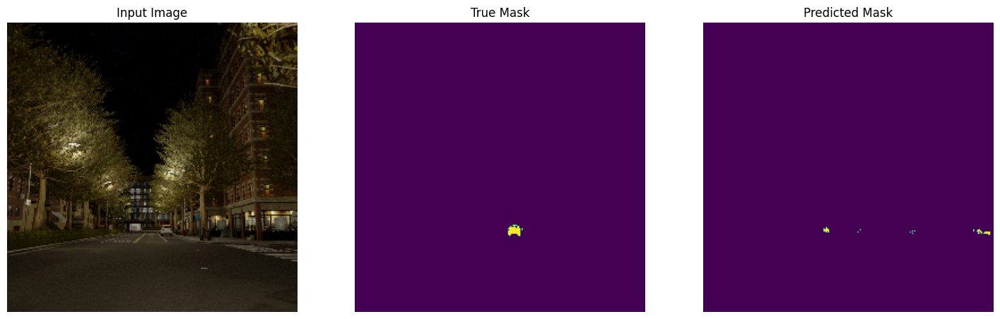

1/1 [==============================] - 0s 116ms/step


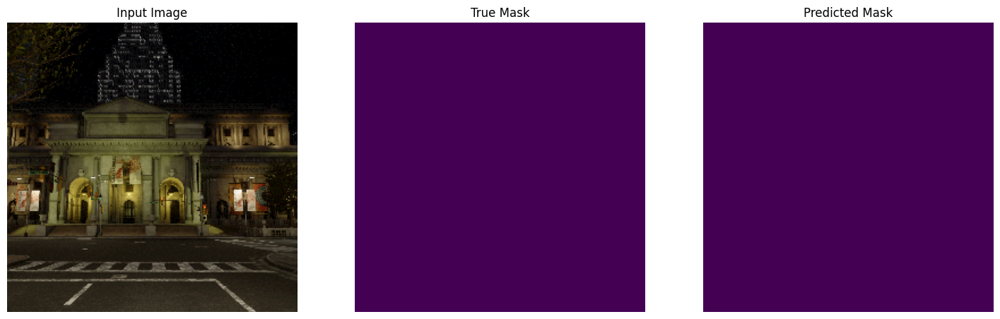

1/1 [==============================] - 0s 114ms/step


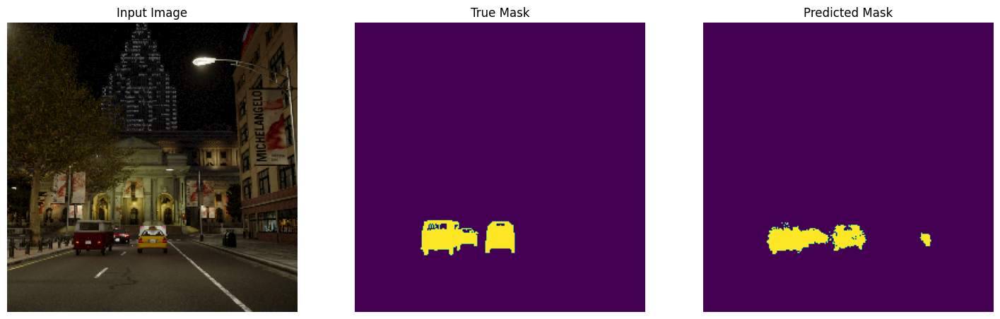

1/1 [==============================] - 0s 116ms/step


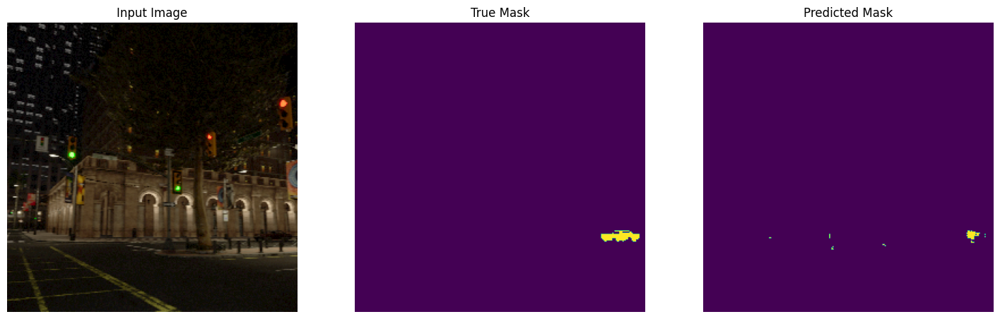

1/1 [==============================] - 0s 115ms/step


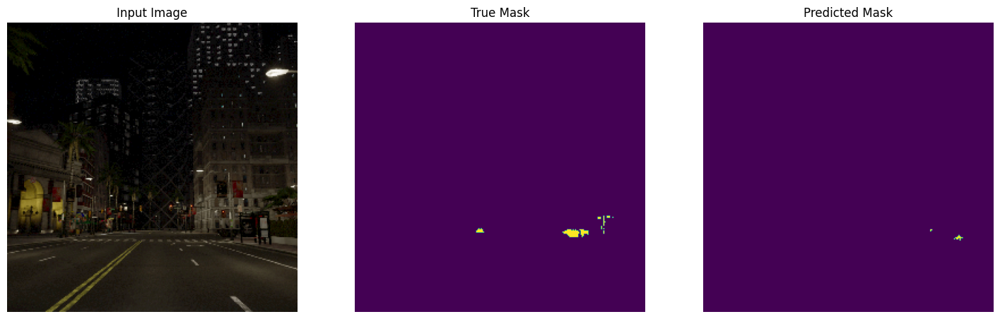

1/1 [==============================] - 0s 115ms/step


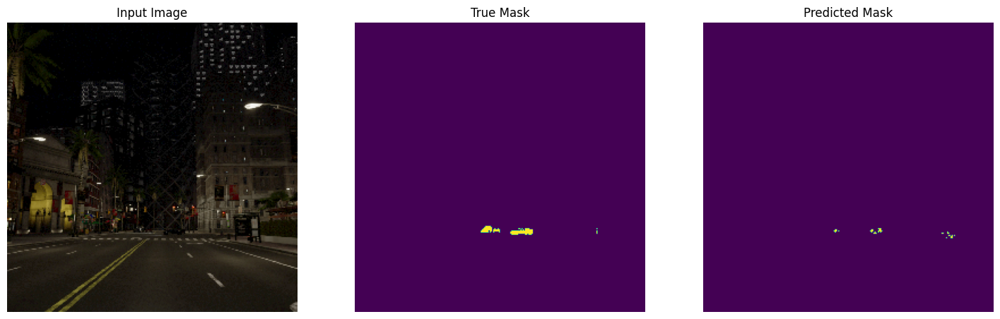

1/1 [==============================] - 0s 117ms/step


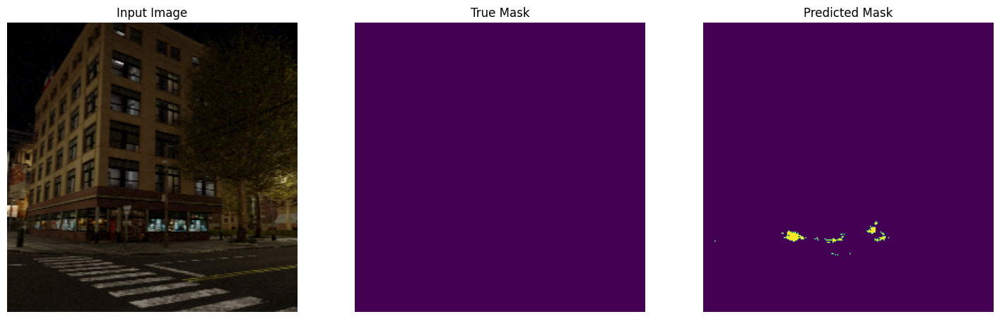

1/1 [==============================] - 0s 115ms/step


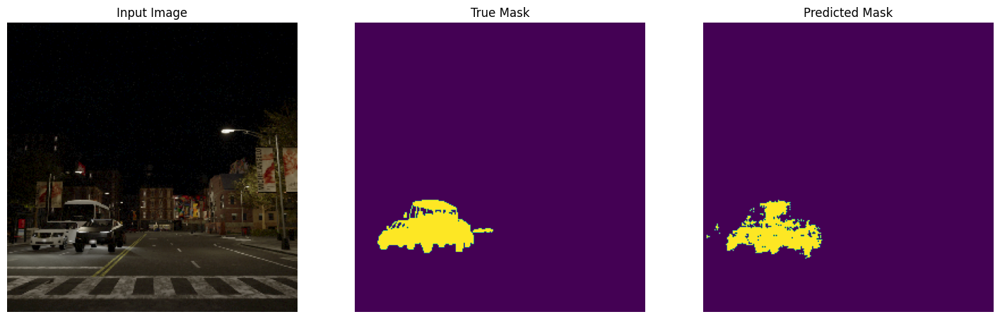

1/1 [==============================] - 0s 116ms/step


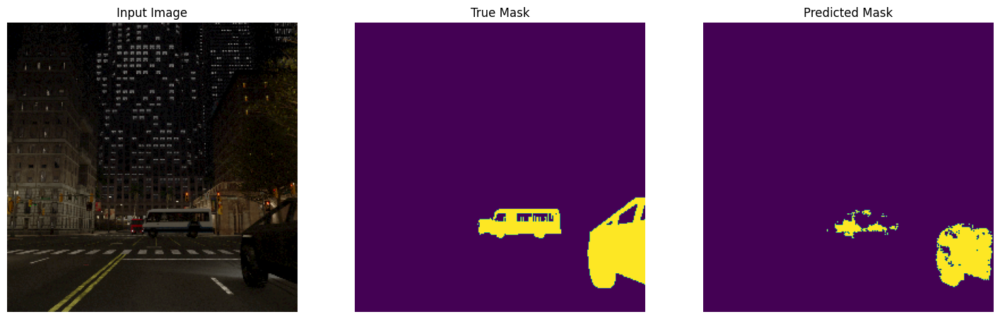

1/1 [==============================] - 0s 116ms/step


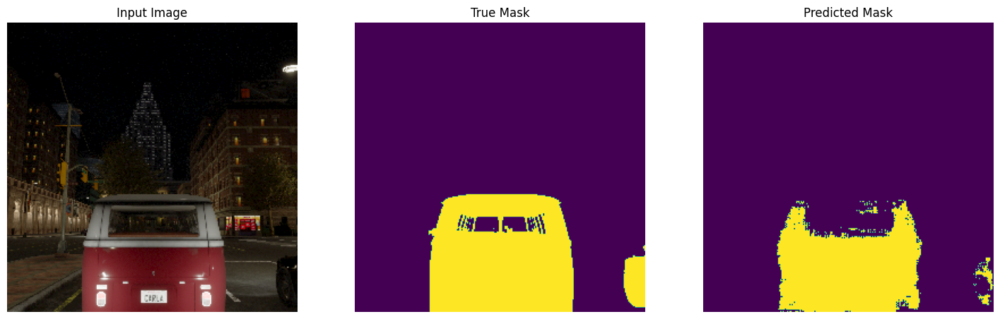

1/1 [==============================] - 0s 116ms/step


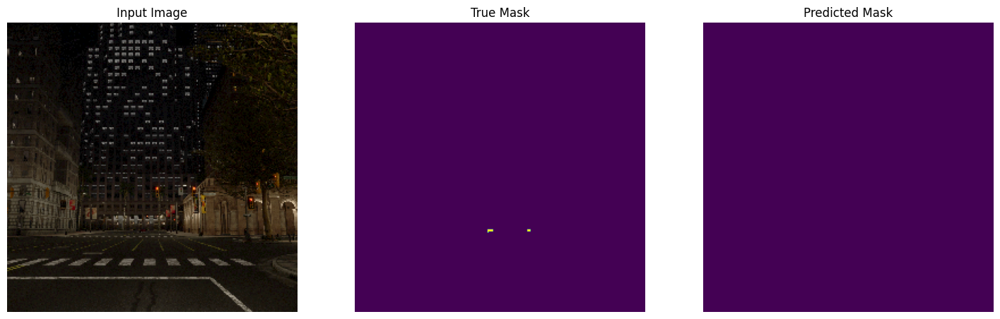

1/1 [==============================] - 0s 117ms/step


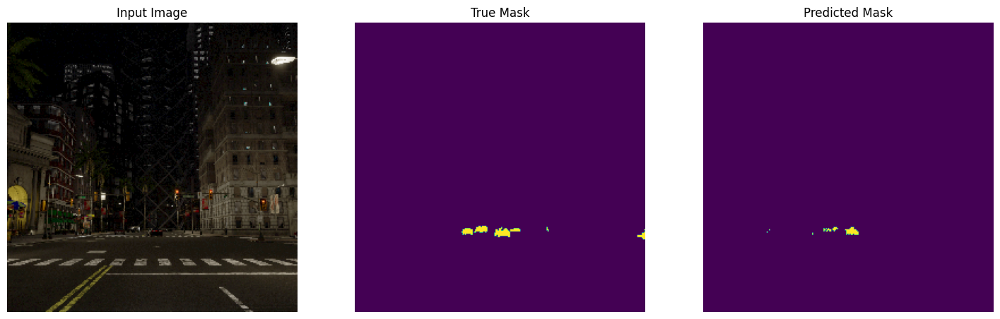

1/1 [==============================] - 0s 114ms/step


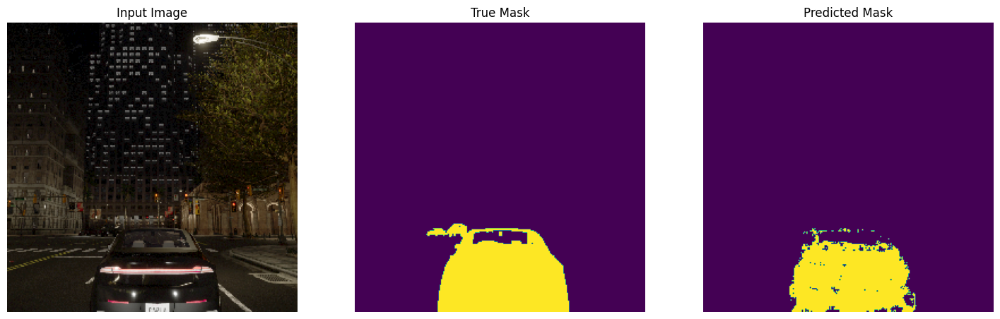

1/1 [==============================] - 0s 115ms/step


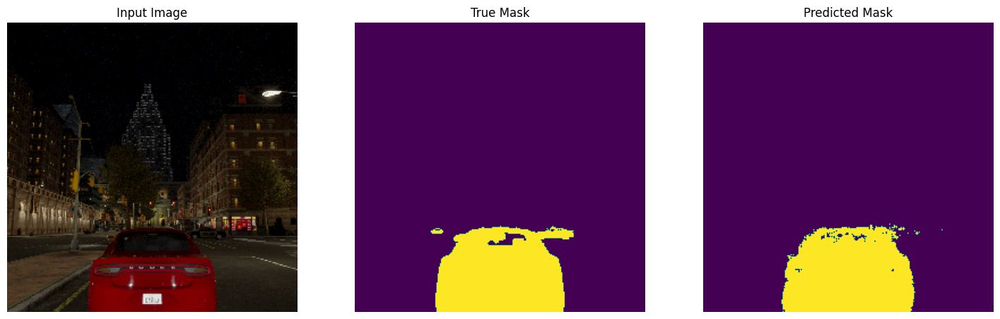

1/1 [==============================] - 0s 120ms/step


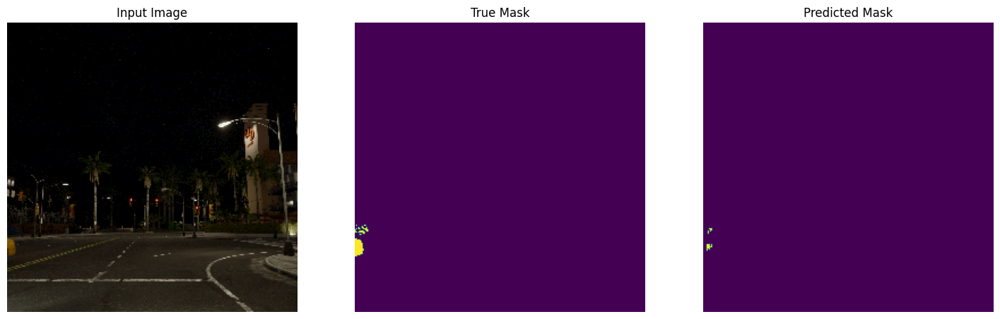

1/1 [==============================] - 0s 117ms/step


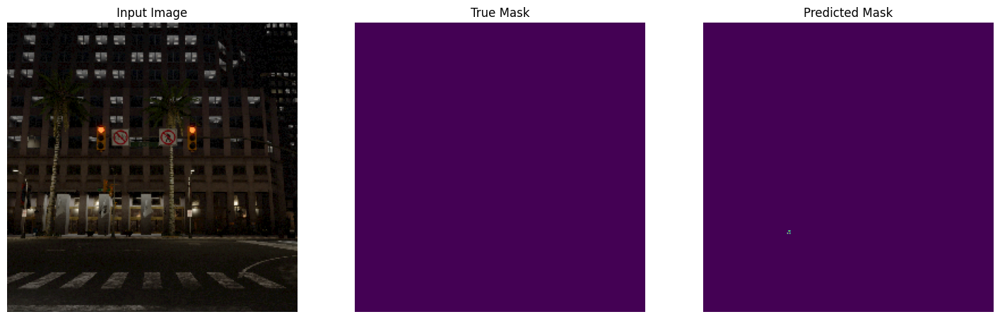

1/1 [==============================] - 0s 119ms/step


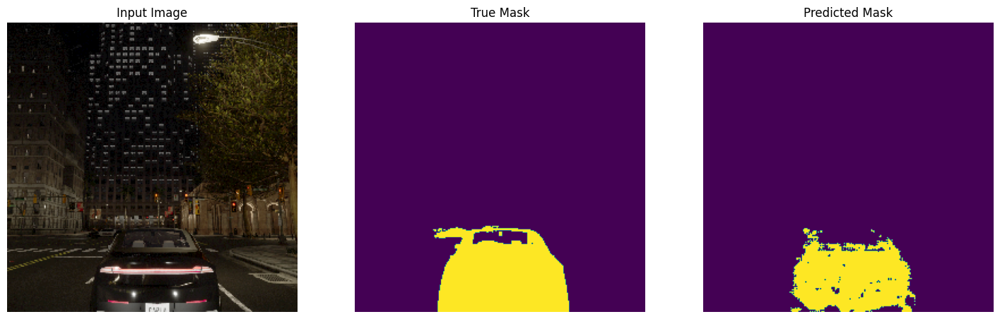

1/1 [==============================] - 0s 119ms/step


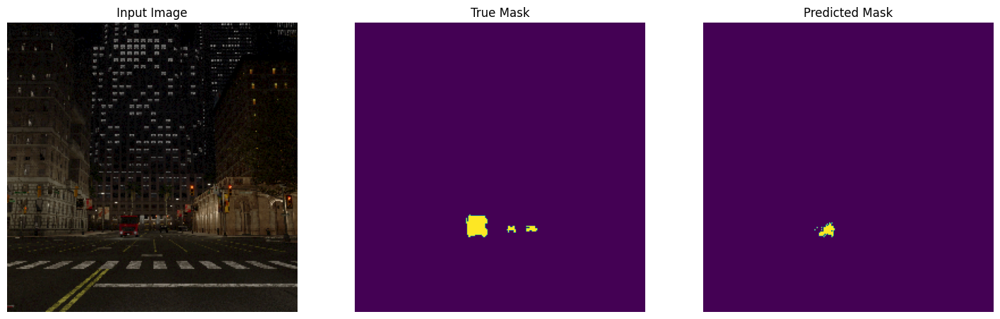

1/1 [==============================] - 0s 116ms/step


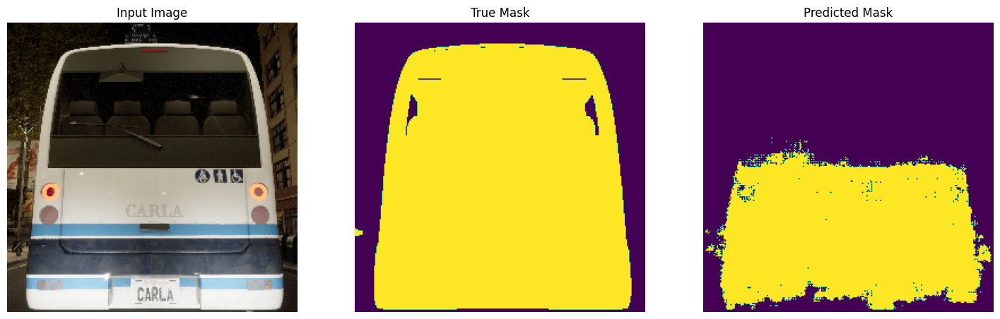

1/1 [==============================] - 0s 117ms/step


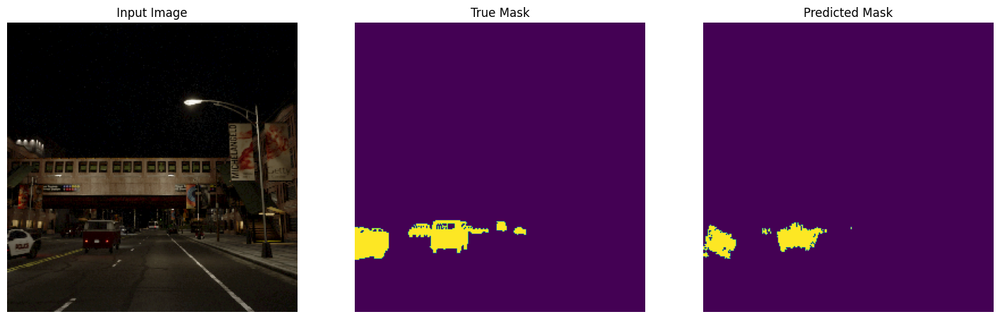

1/1 [==============================] - 0s 117ms/step


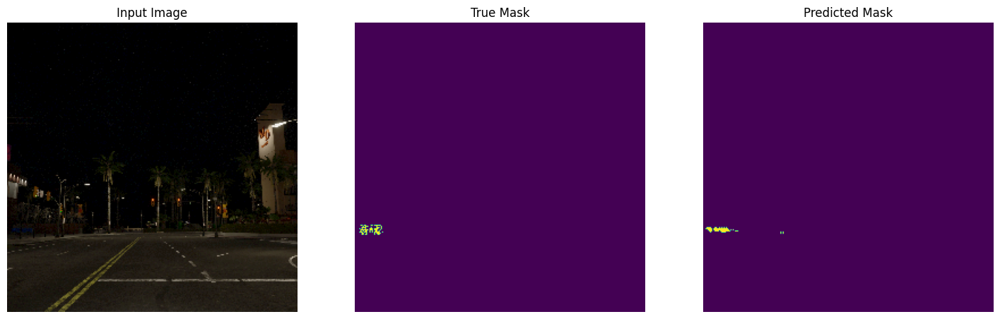

1/1 [==============================] - 0s 113ms/step


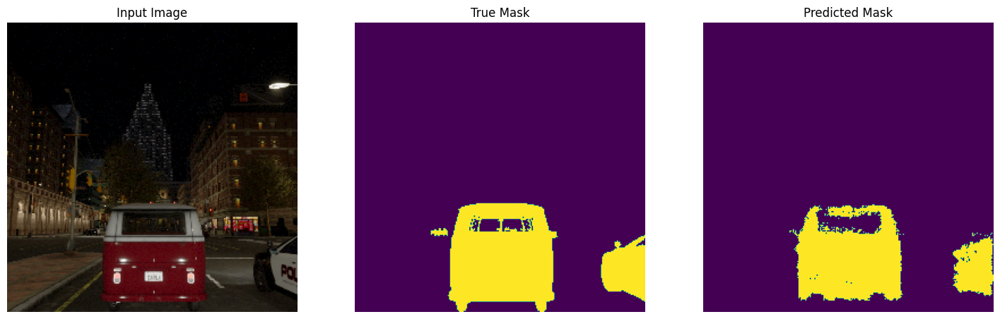

1/1 [==============================] - 0s 117ms/step


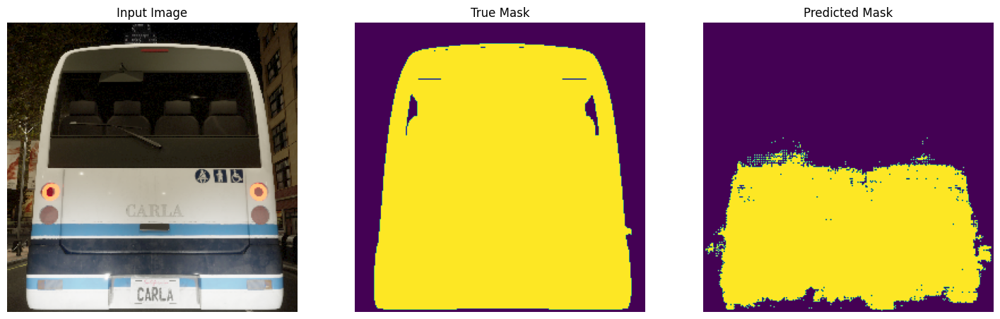

1/1 [==============================] - 0s 113ms/step


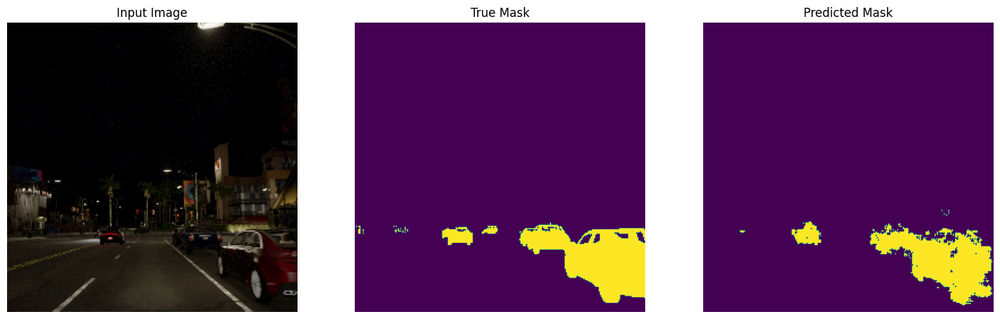

1/1 [==============================] - 0s 124ms/step


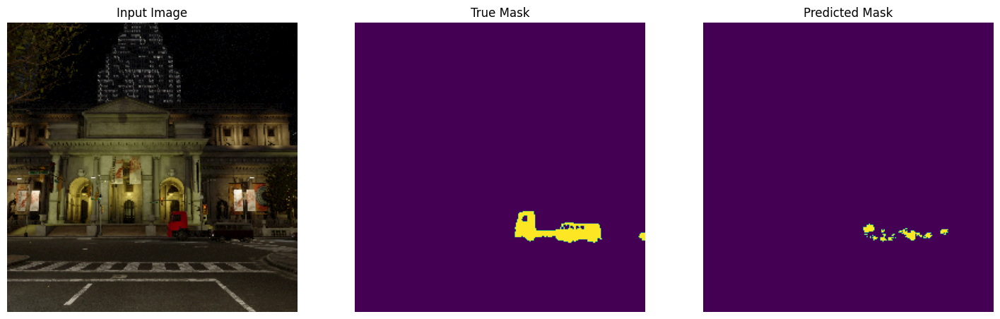

1/1 [==============================] - 0s 127ms/step


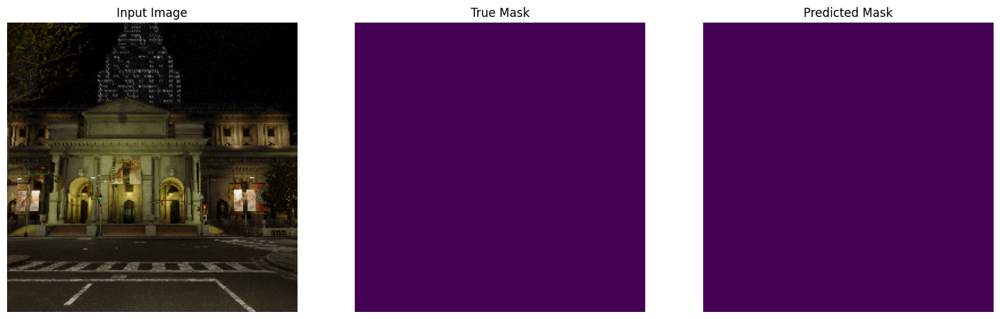

1/1 [==============================] - 0s 117ms/step


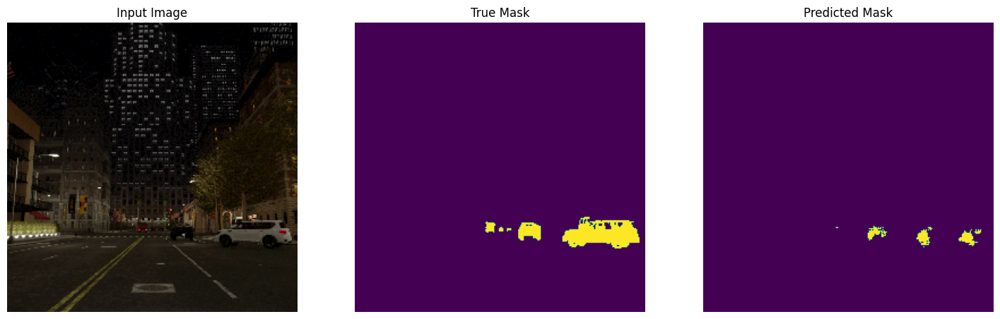

1/1 [==============================] - 0s 118ms/step


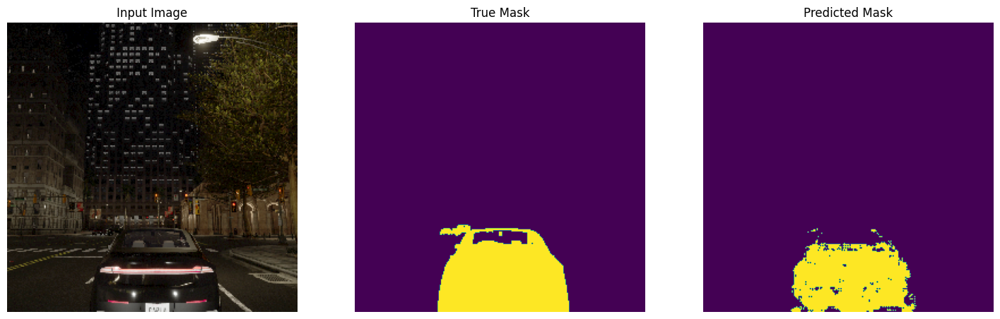

1/1 [==============================] - 0s 117ms/step


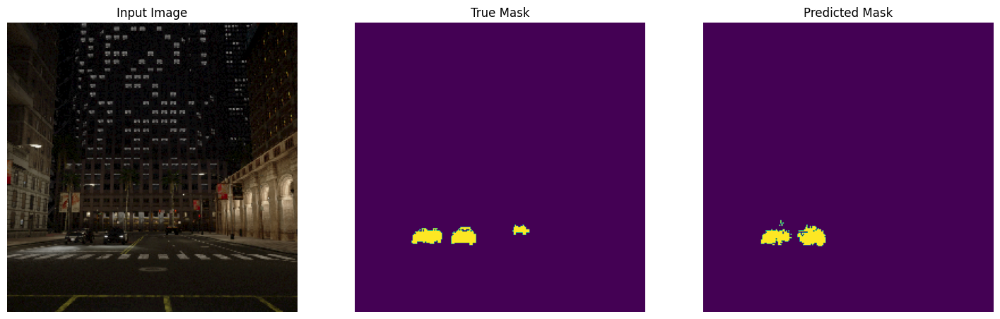

1/1 [==============================] - 0s 122ms/step


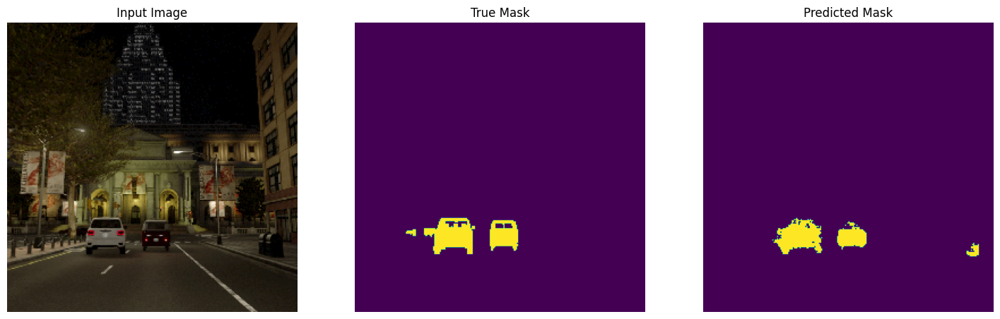

1/1 [==============================] - 0s 127ms/step


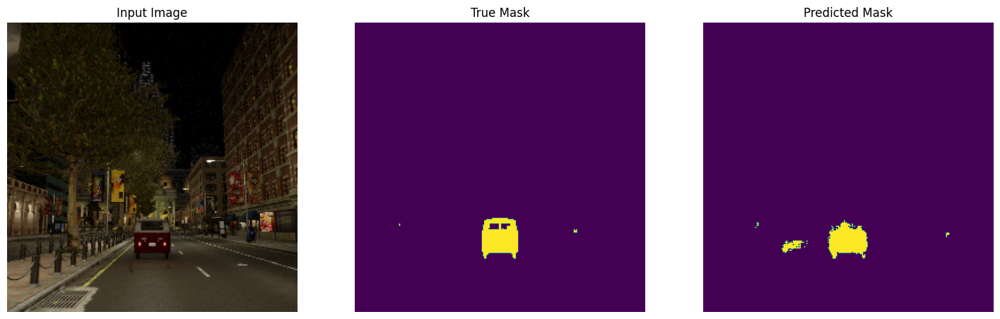

1/1 [==============================] - 0s 124ms/step


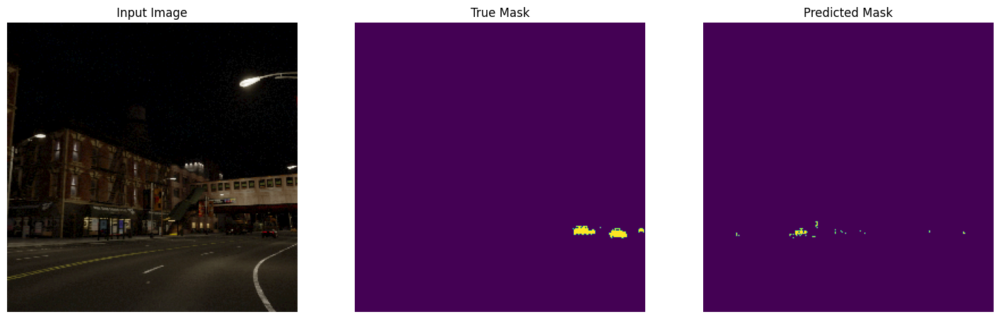

1/1 [==============================] - 0s 118ms/step


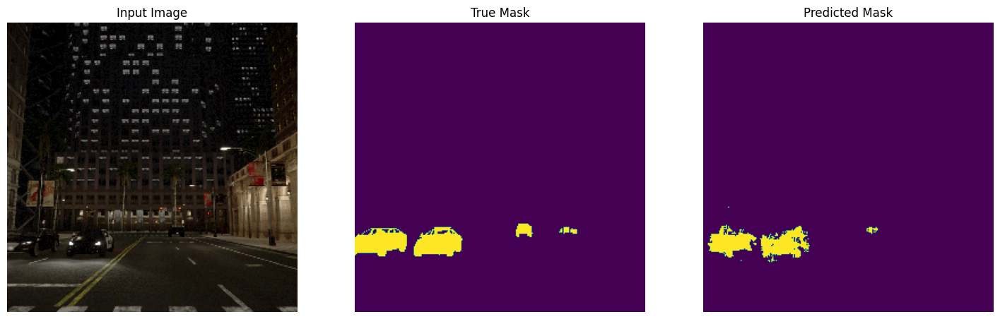

1/1 [==============================] - 0s 117ms/step


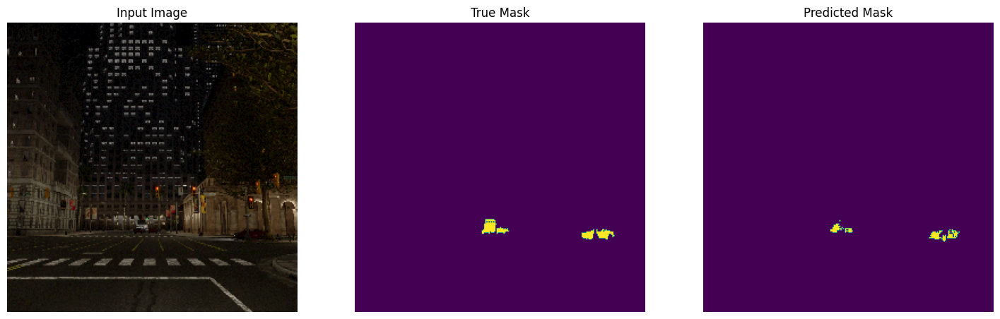

1/1 [==============================] - 0s 117ms/step


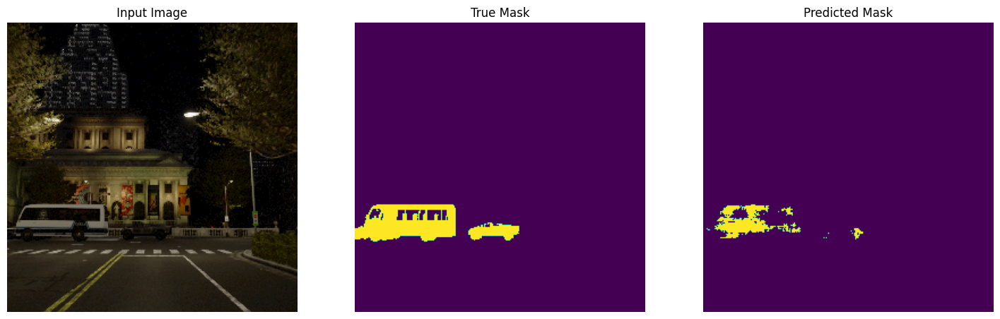

1/1 [==============================] - 0s 120ms/step


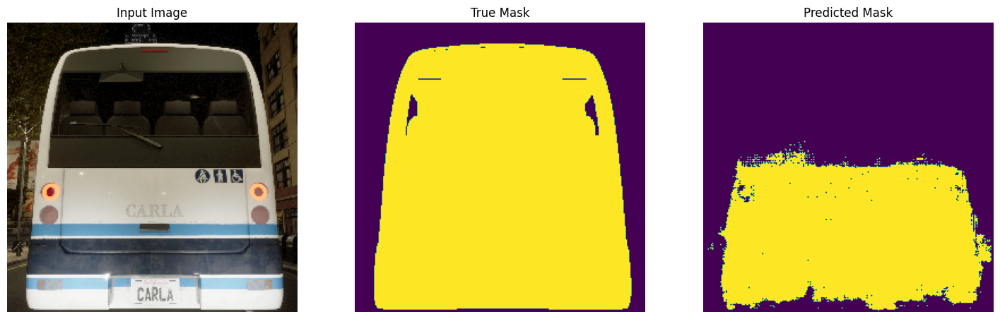

1/1 [==============================] - 0s 121ms/step


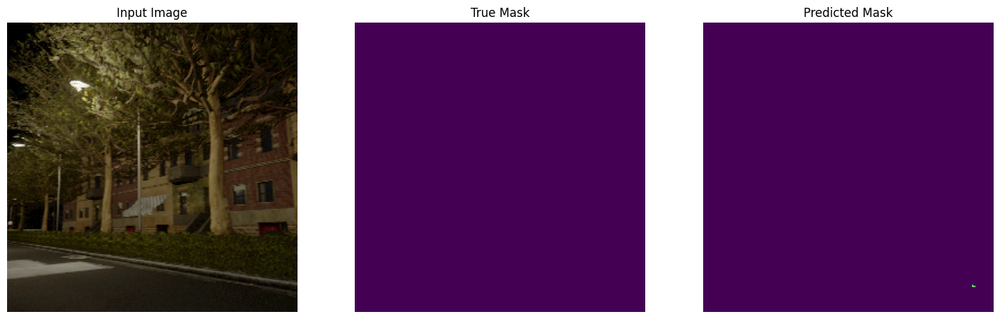

1/1 [==============================] - 0s 113ms/step


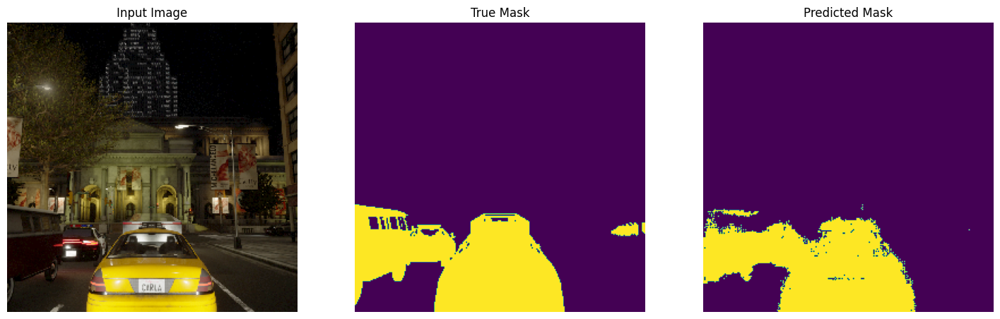

1/1 [==============================] - 0s 119ms/step


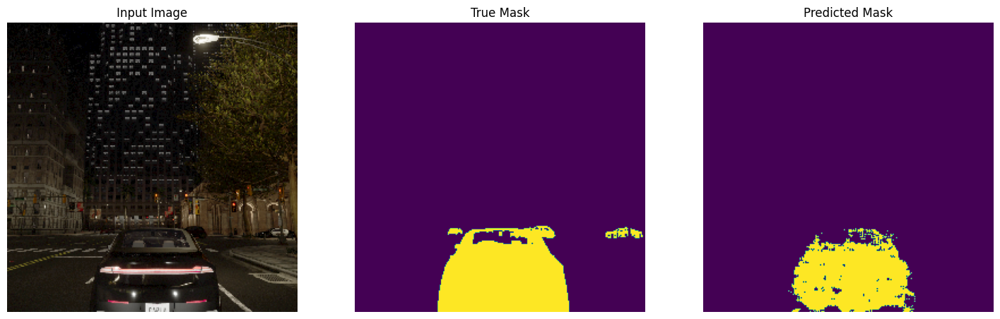

1/1 [==============================] - 0s 116ms/step


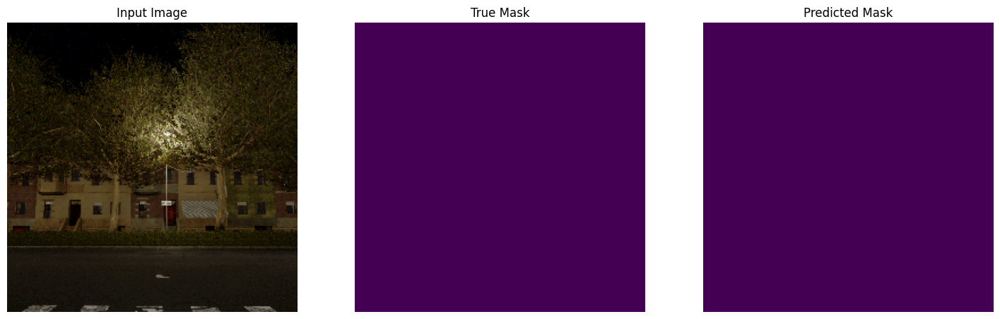

1/1 [==============================] - 0s 124ms/step


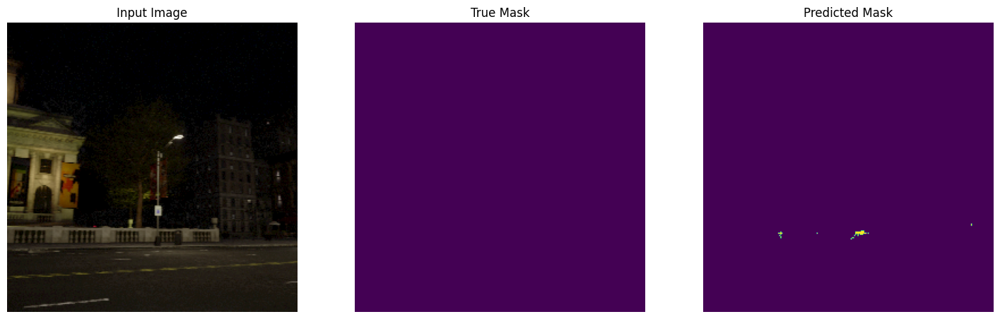

1/1 [==============================] - 0s 123ms/step


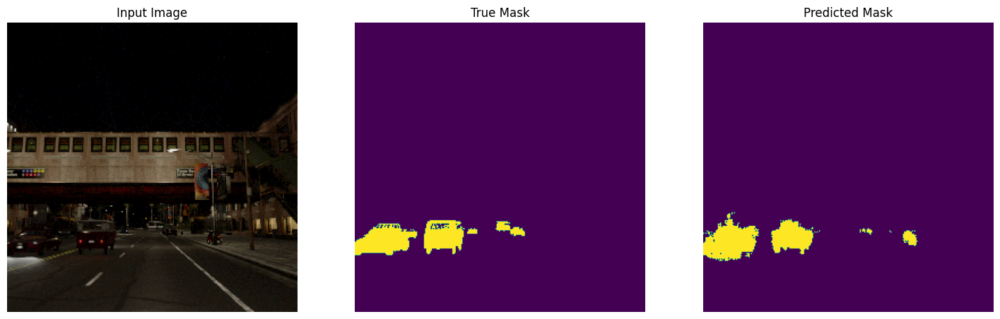

1/1 [==============================] - 0s 119ms/step


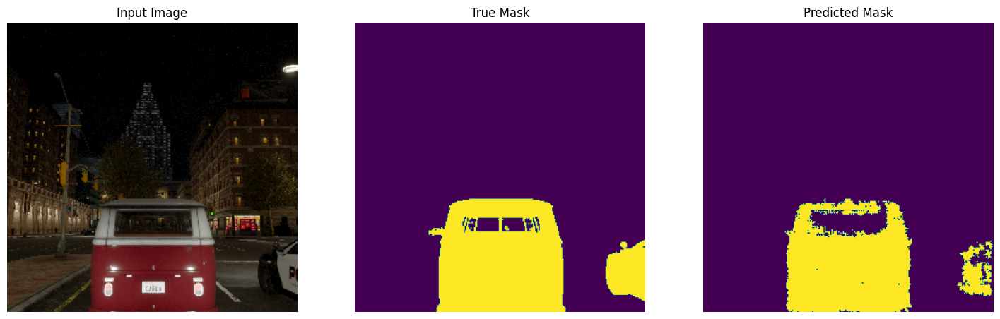

1/1 [==============================] - 0s 119ms/step


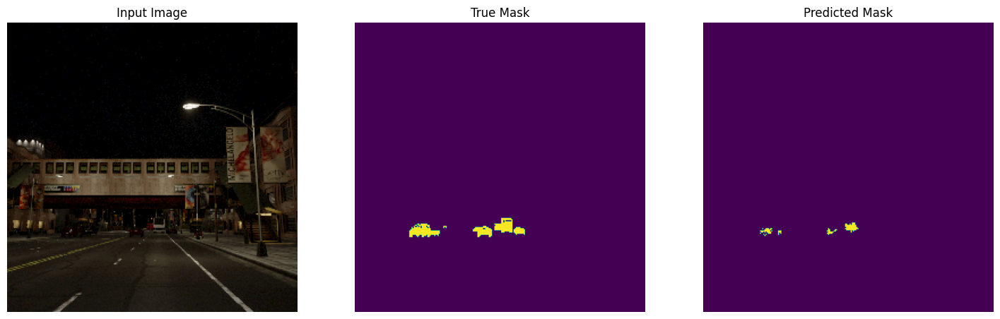

1/1 [==============================] - 0s 119ms/step


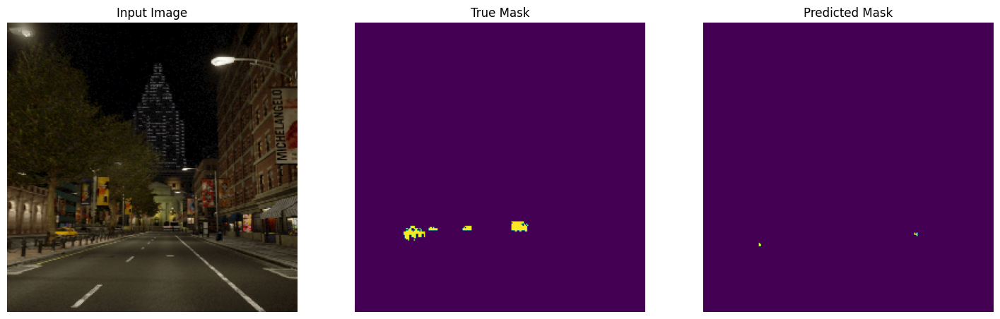

1/1 [==============================] - 0s 119ms/step


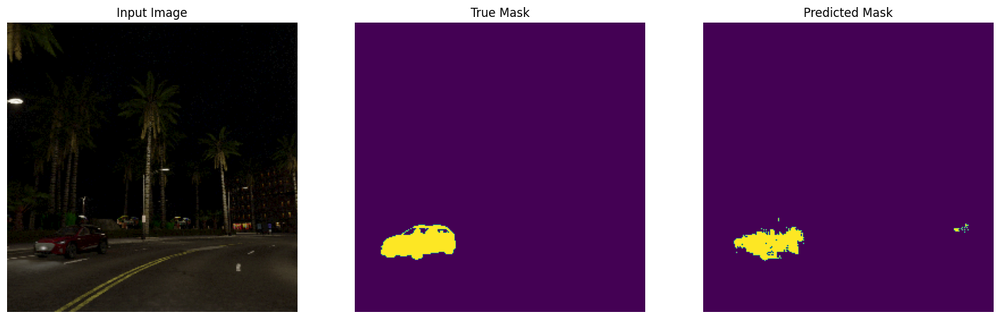

1/1 [==============================] - 0s 120ms/step


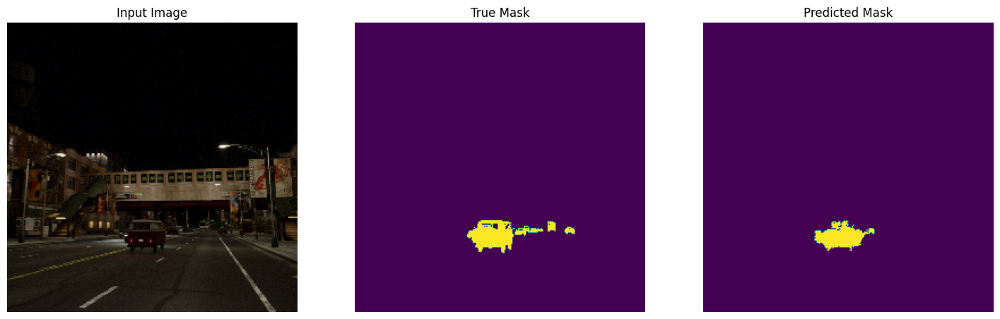

1/1 [==============================] - 0s 120ms/step


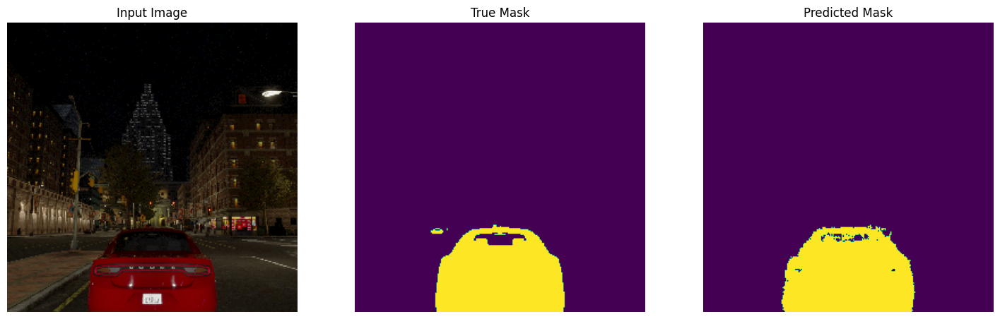

1/1 [==============================] - 0s 123ms/step


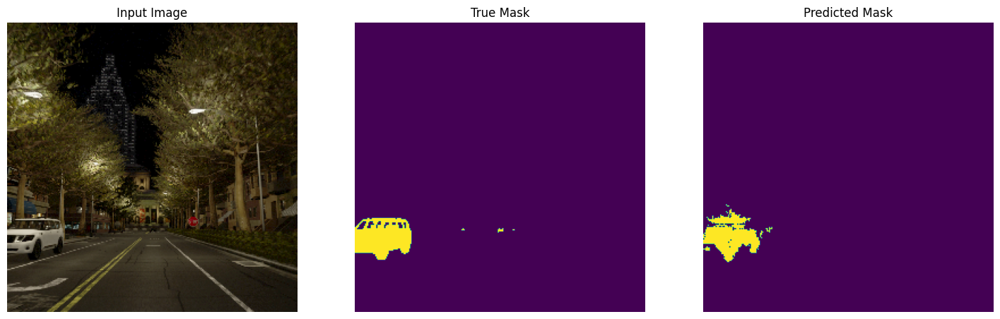

1/1 [==============================] - 0s 121ms/step


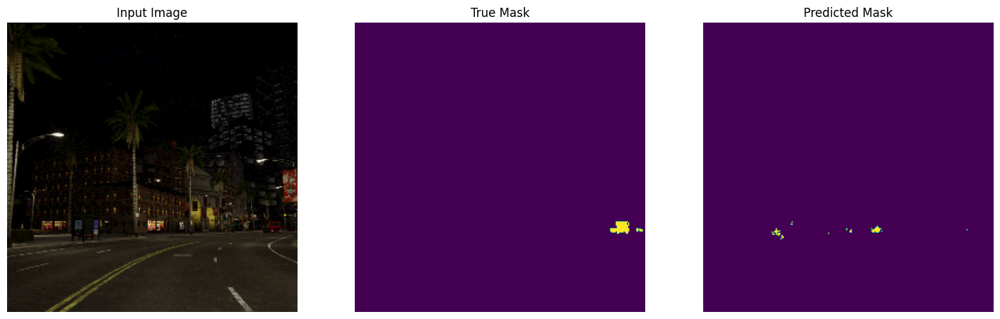

1/1 [==============================] - 0s 118ms/step


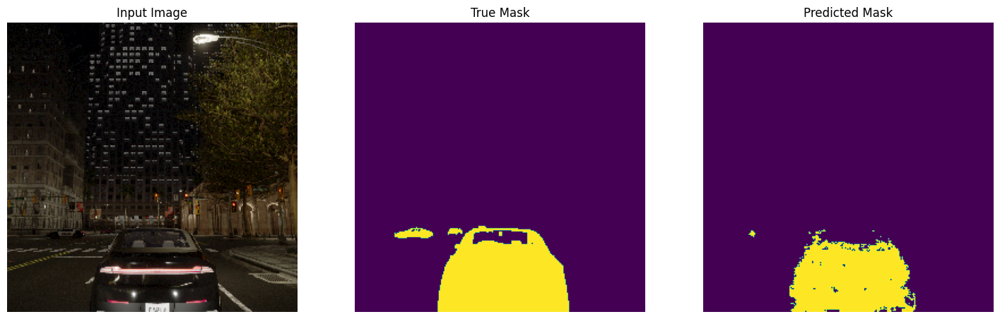

1/1 [==============================] - 0s 118ms/step


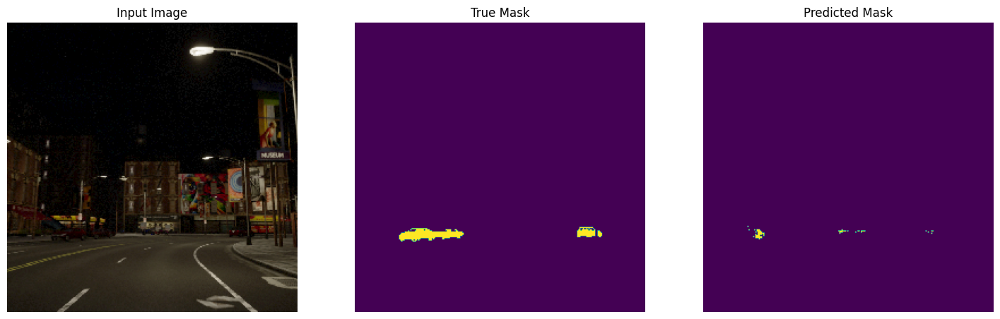

1/1 [==============================] - 0s 117ms/step


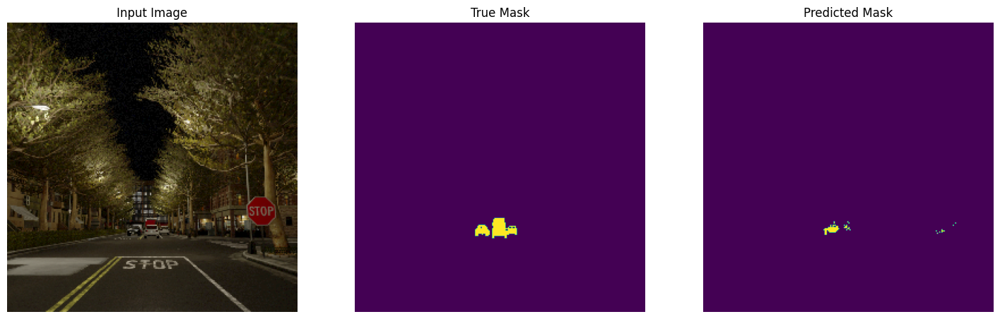

1/1 [==============================] - 0s 118ms/step


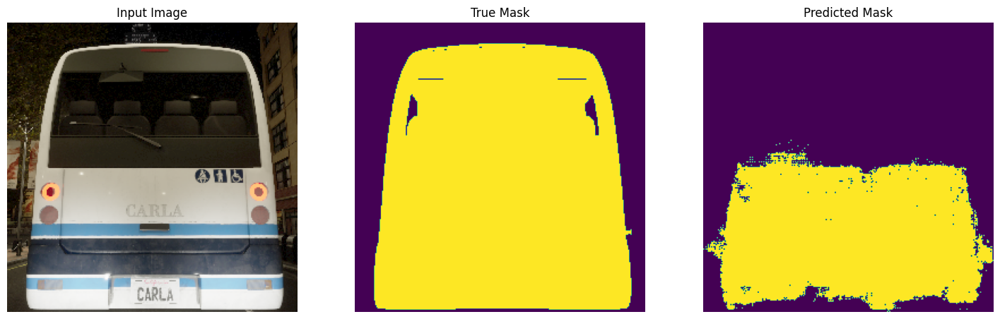

1/1 [==============================] - 0s 113ms/step


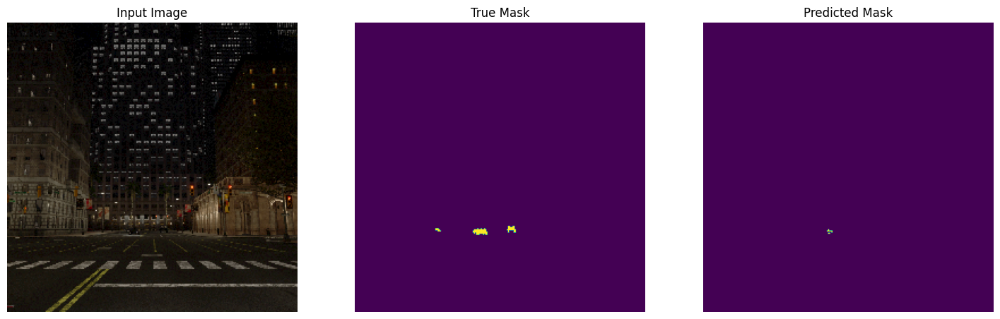

1/1 [==============================] - 0s 113ms/step


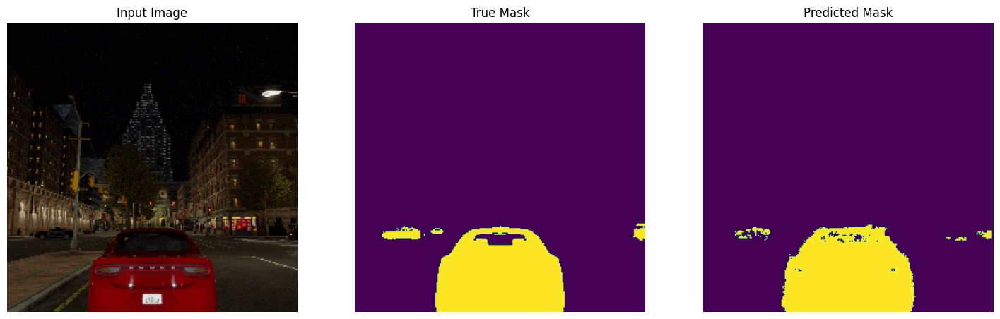

1/1 [==============================] - 0s 118ms/step


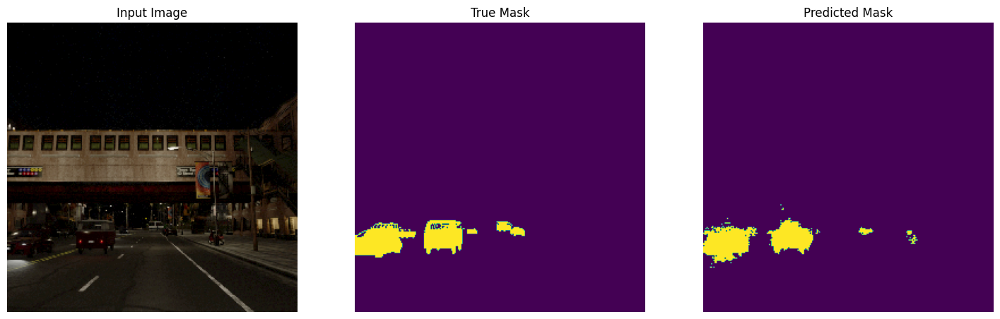

1/1 [==============================] - 0s 114ms/step


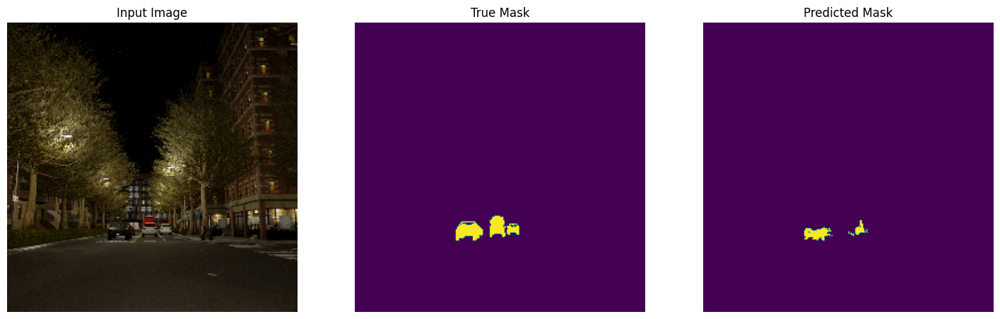

1/1 [==============================] - 0s 118ms/step


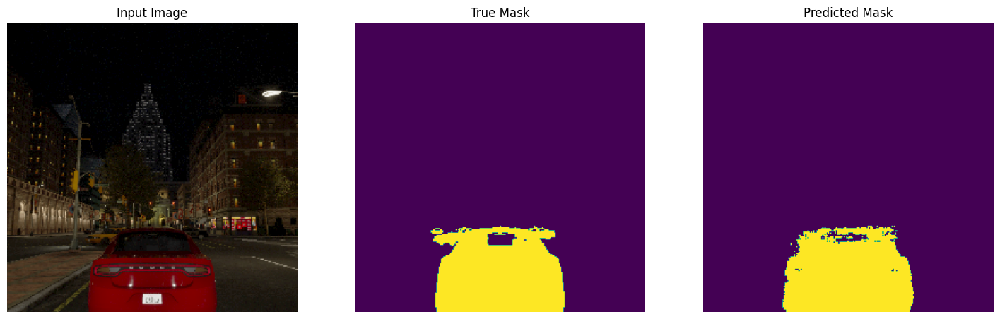

1/1 [==============================] - 0s 117ms/step


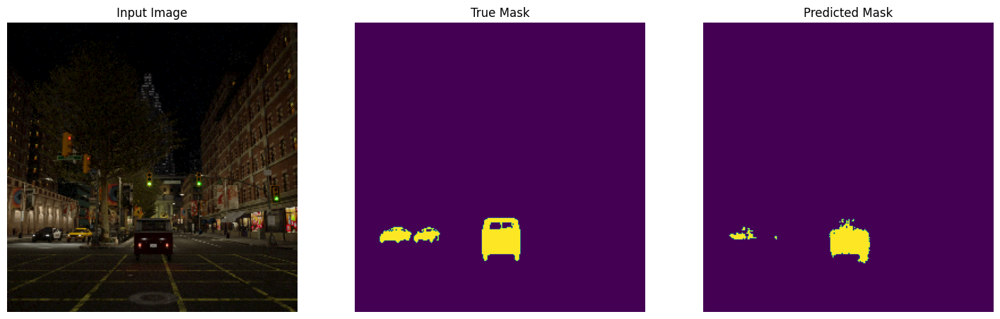

1/1 [==============================] - 0s 119ms/step


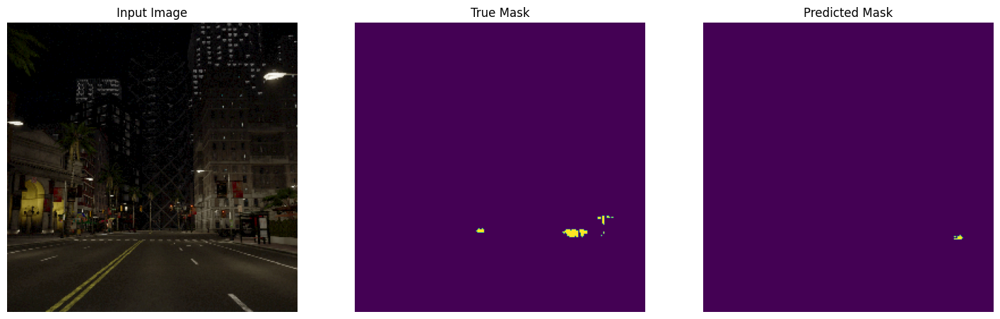

1/1 [==============================] - 0s 117ms/step


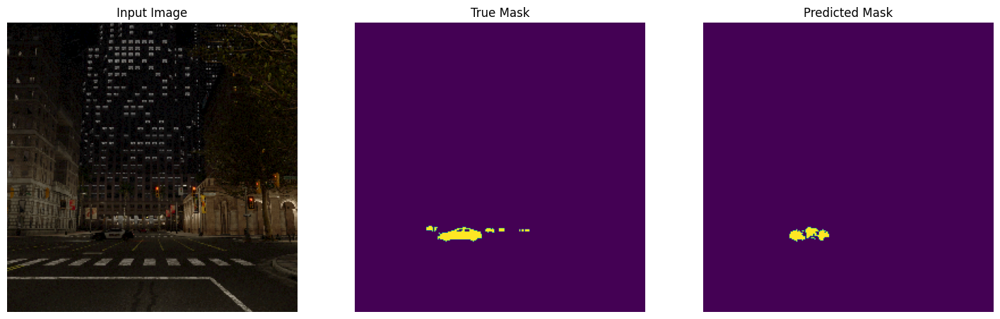

1/1 [==============================] - 0s 112ms/step


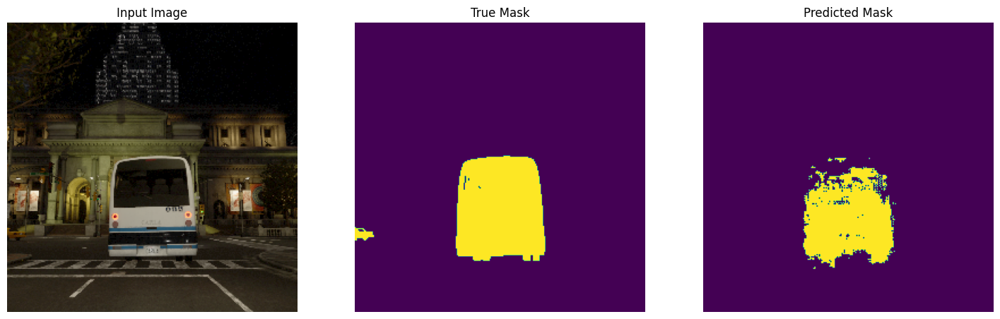

1/1 [==============================] - 0s 123ms/step


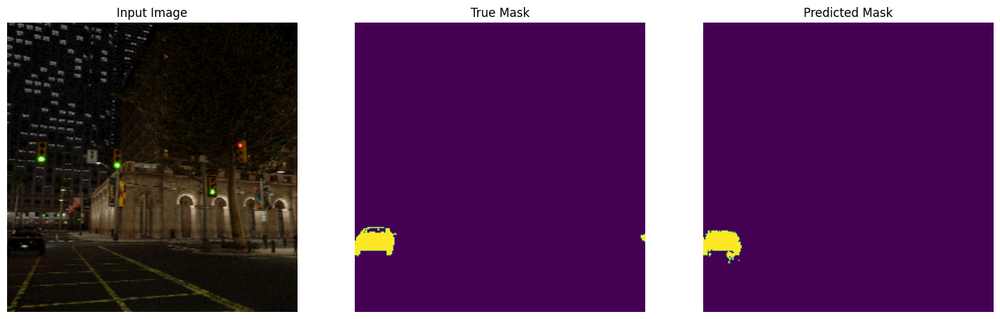

1/1 [==============================] - 0s 121ms/step


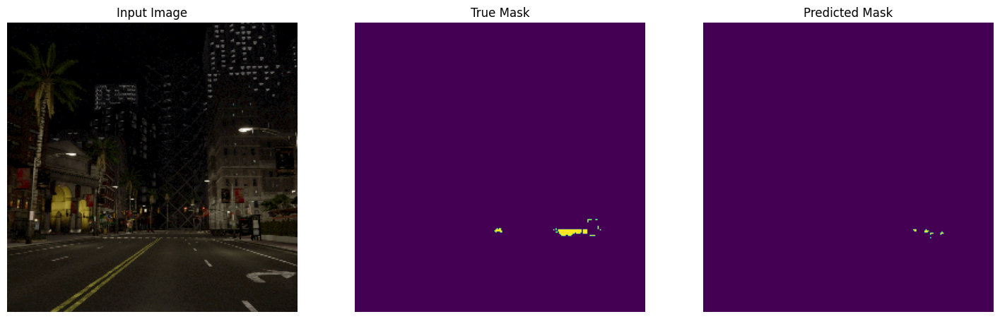

1/1 [==============================] - 0s 120ms/step


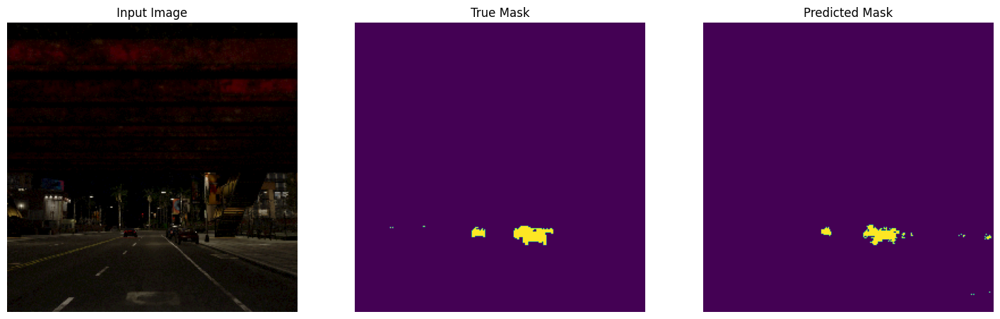

1/1 [==============================] - 0s 122ms/step


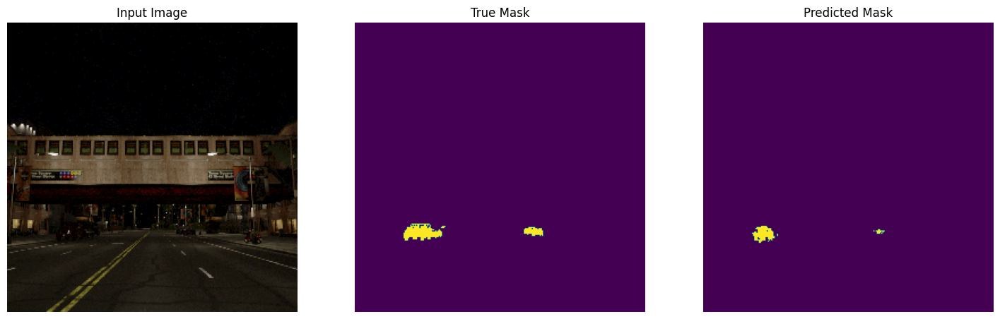

1/1 [==============================] - 0s 120ms/step


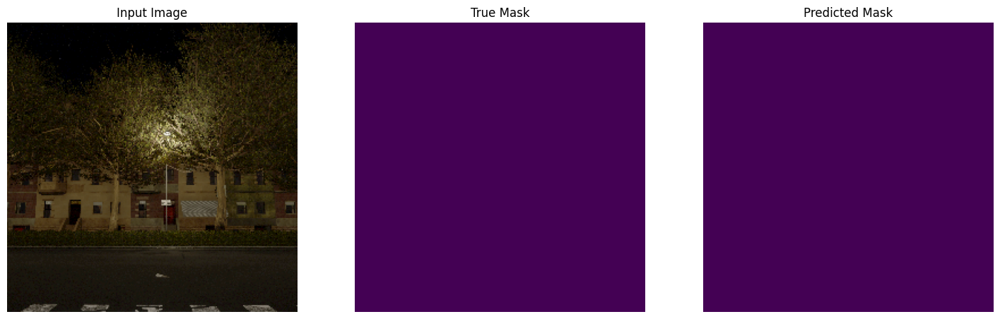

1/1 [==============================] - 0s 119ms/step


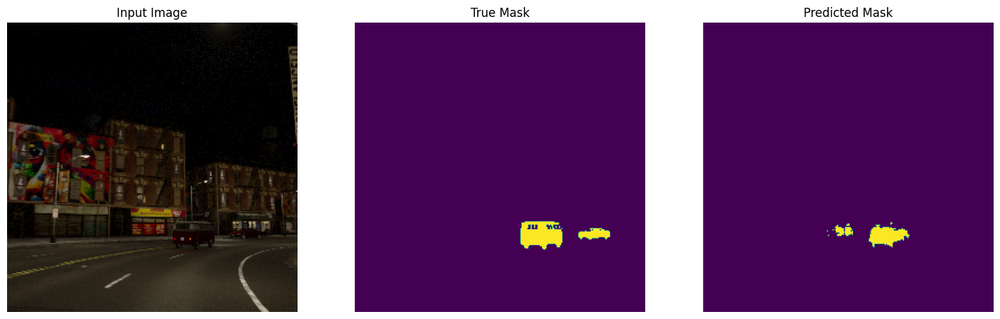

1/1 [==============================] - 0s 121ms/step


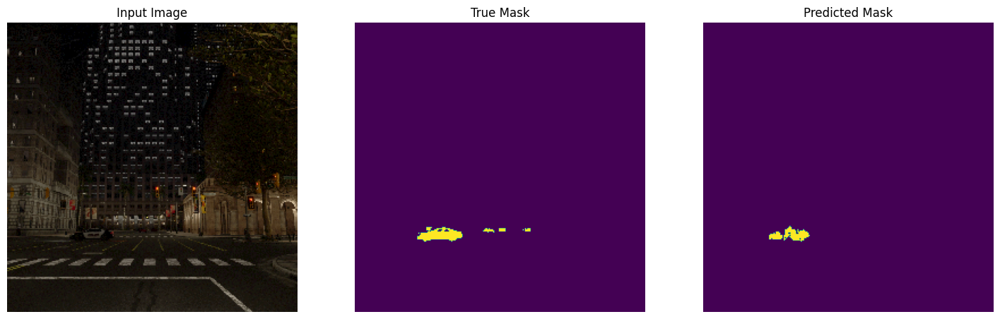

1/1 [==============================] - 0s 119ms/step


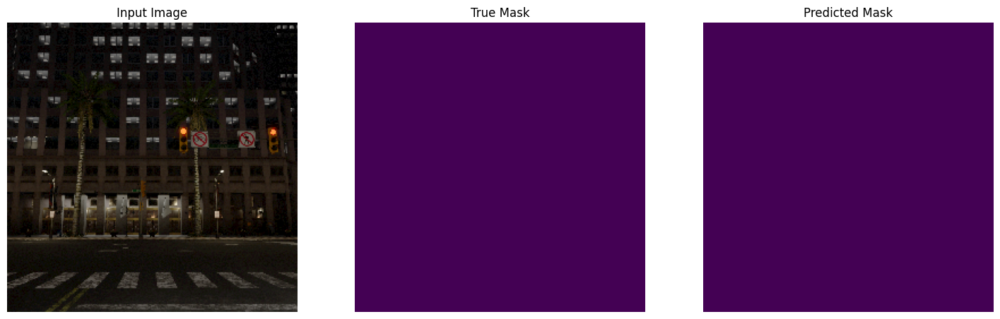

1/1 [==============================] - 0s 122ms/step


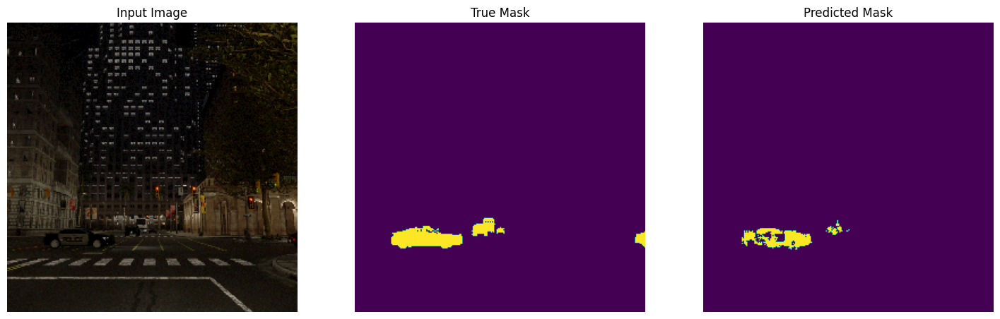

1/1 [==============================] - 0s 121ms/step


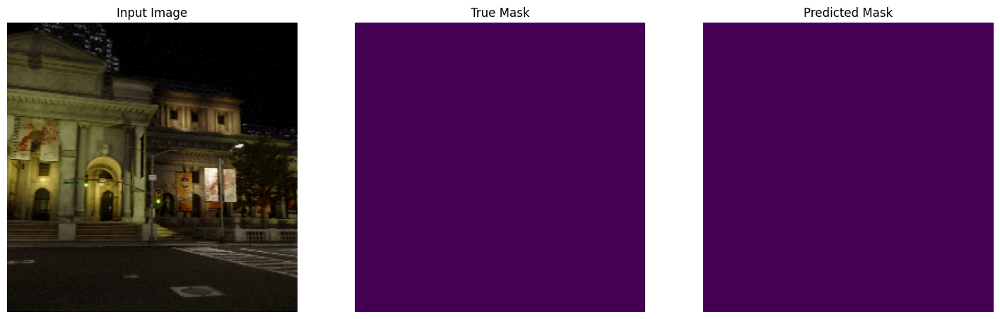

1/1 [==============================] - 0s 120ms/step


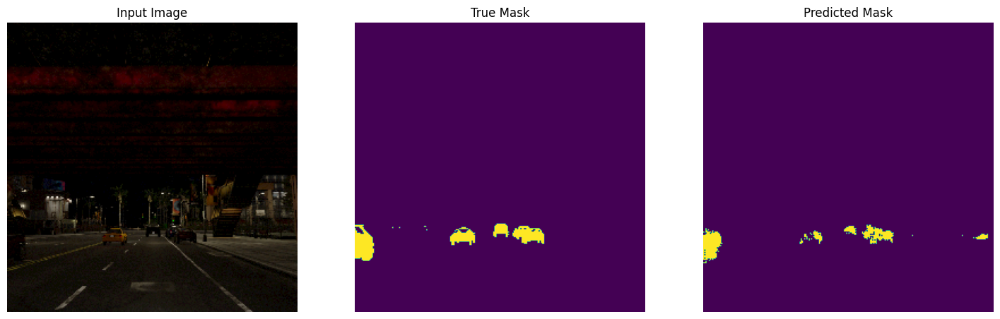

1/1 [==============================] - 0s 121ms/step


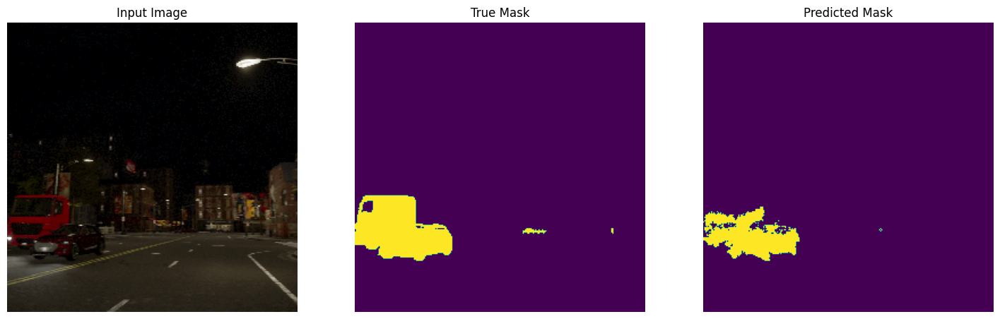

1/1 [==============================] - 0s 120ms/step


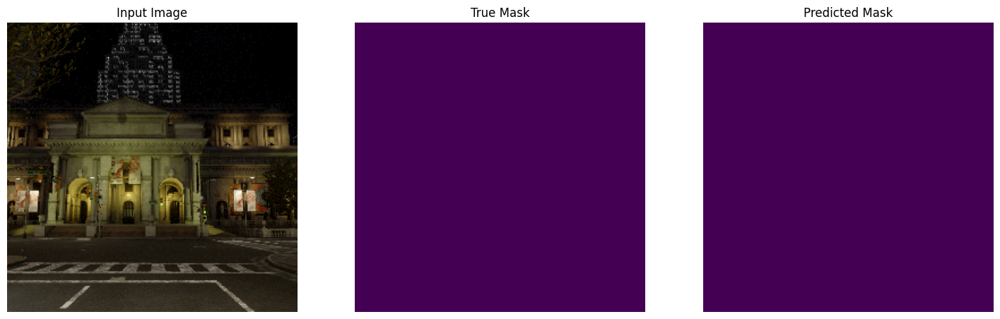

1/1 [==============================] - 0s 126ms/step


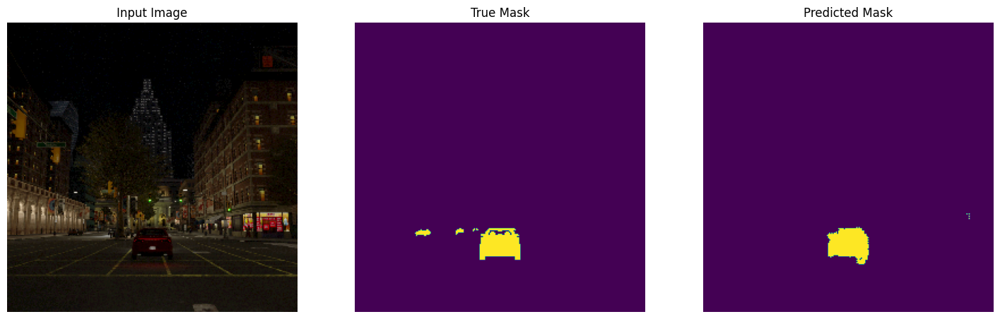

1/1 [==============================] - 0s 121ms/step


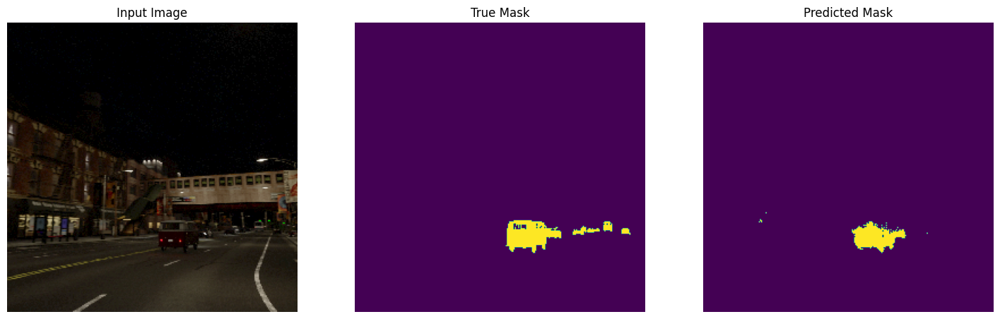

1/1 [==============================] - 0s 120ms/step


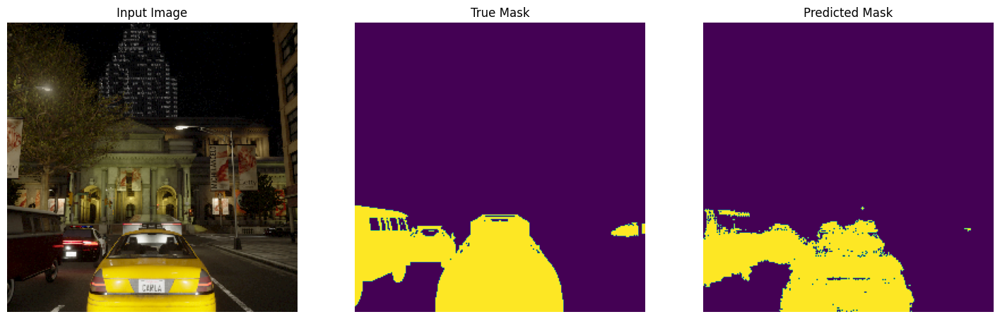

1/1 [==============================] - 0s 121ms/step


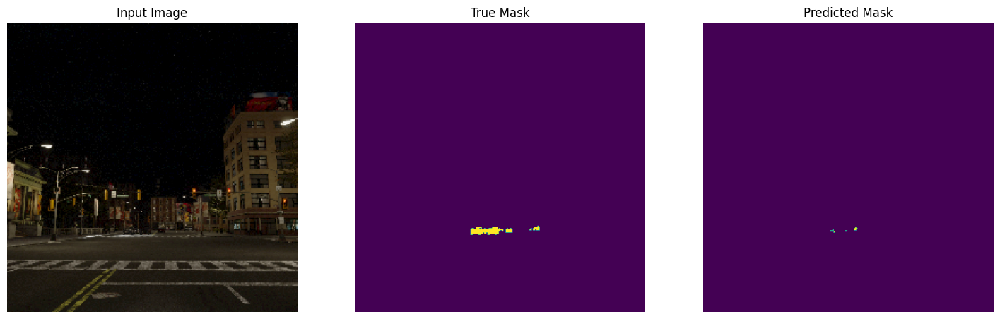

1/1 [==============================] - 0s 121ms/step


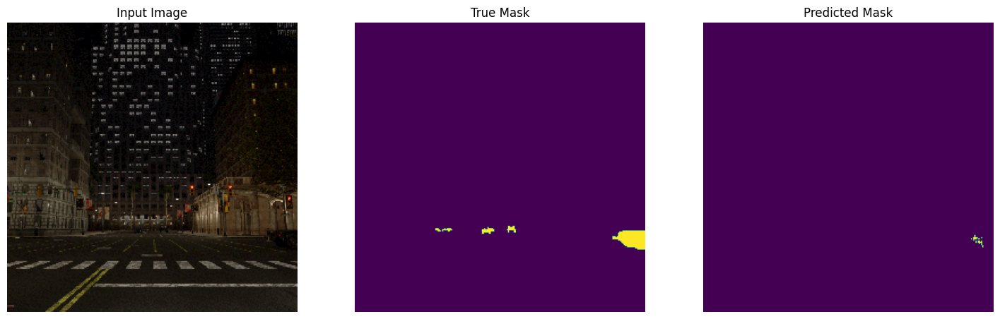

1/1 [==============================] - 0s 120ms/step


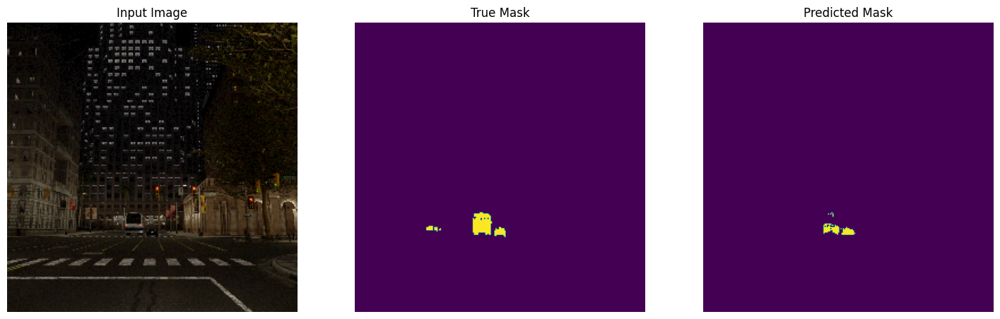

1/1 [==============================] - 0s 120ms/step


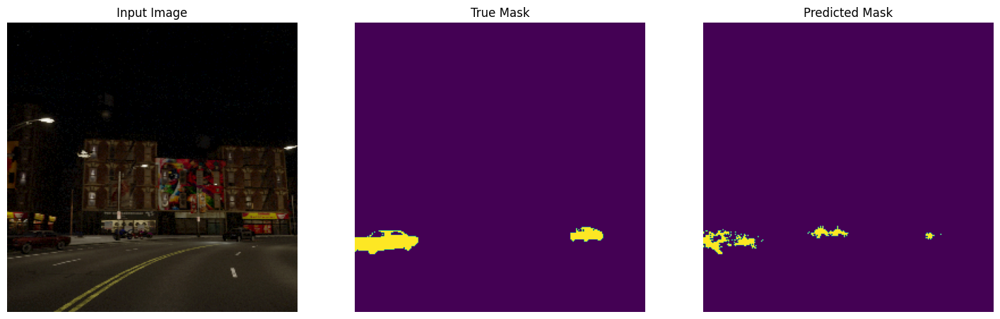

1/1 [==============================] - 0s 119ms/step


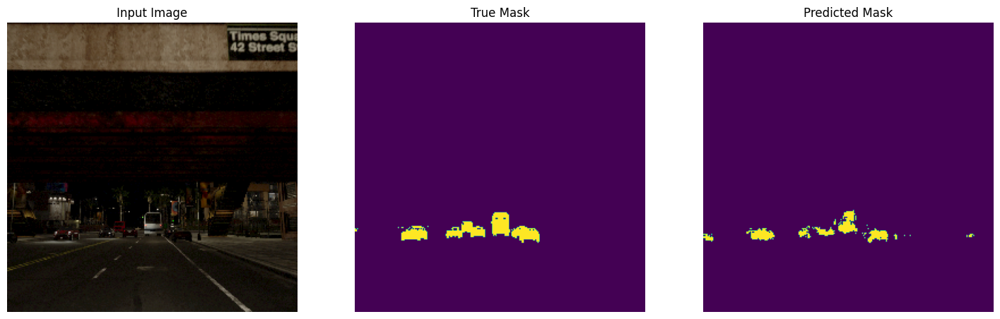

1/1 [==============================] - 0s 120ms/step


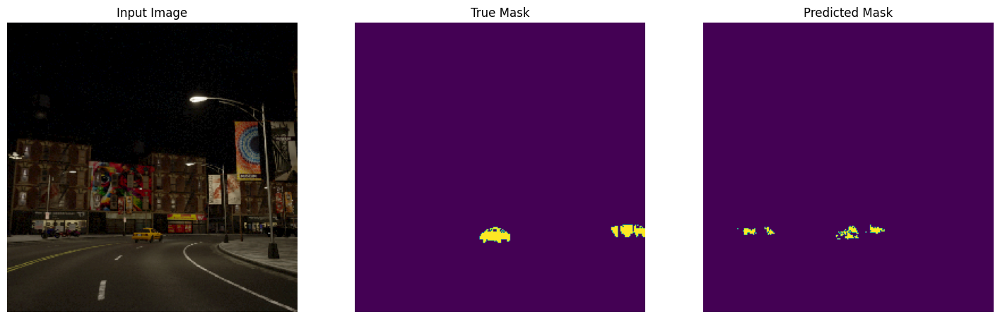

1/1 [==============================] - 0s 120ms/step


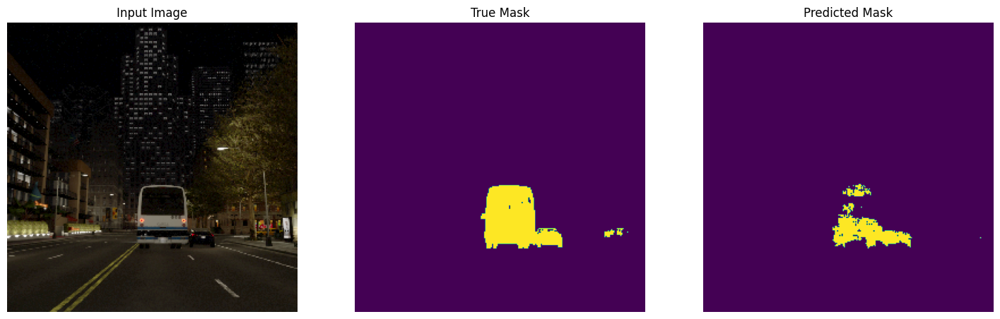

1/1 [==============================] - 0s 120ms/step


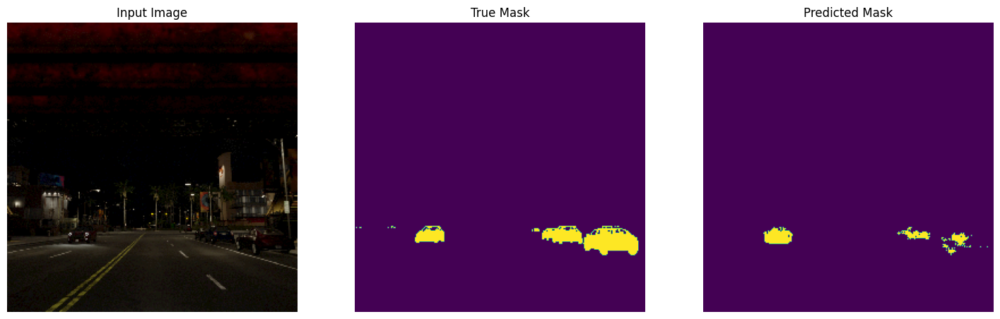

1/1 [==============================] - 0s 120ms/step


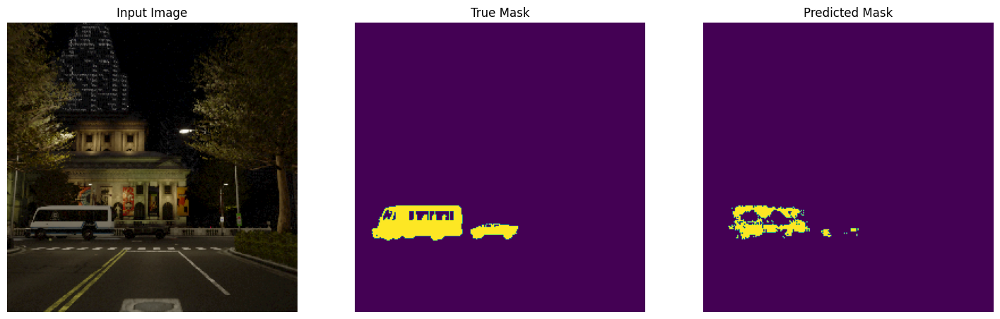

1/1 [==============================] - 0s 120ms/step


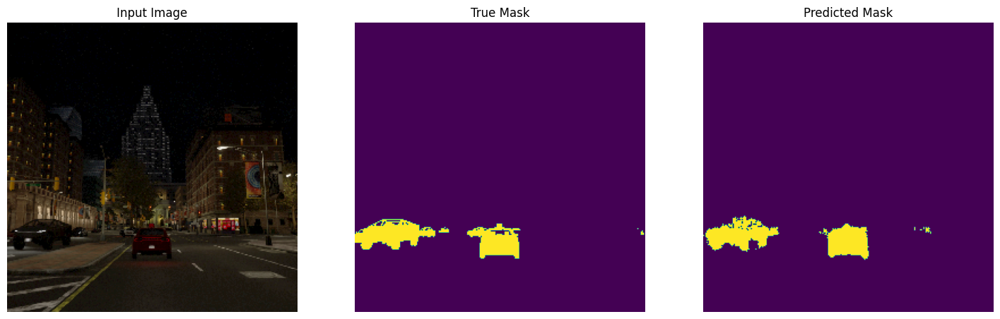

1/1 [==============================] - 0s 120ms/step


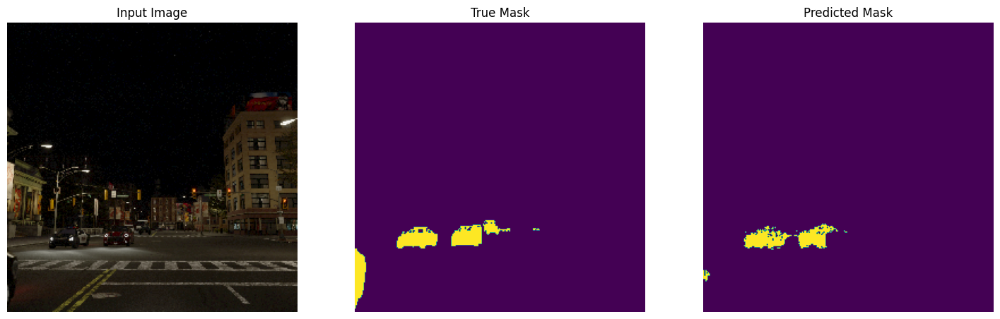

1/1 [==============================] - 0s 120ms/step


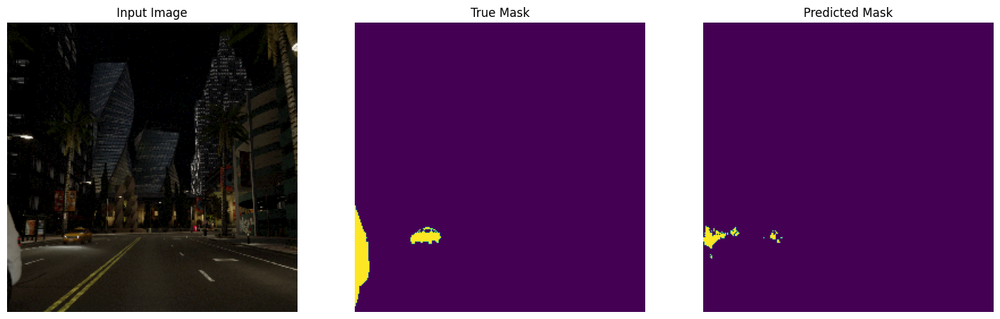

1/1 [==============================] - 0s 121ms/step


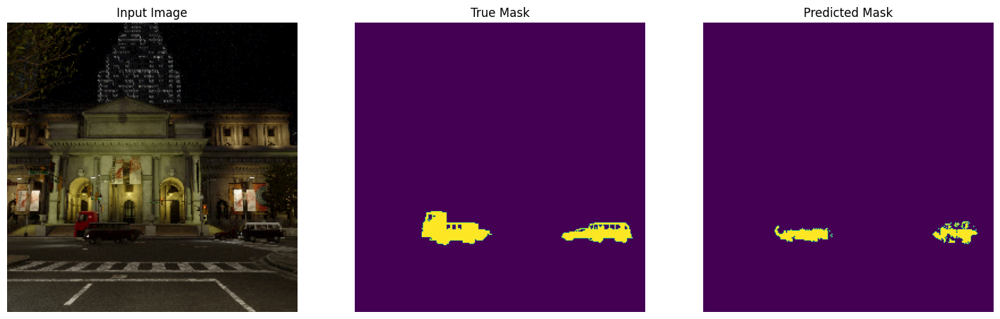

1/1 [==============================] - 0s 120ms/step


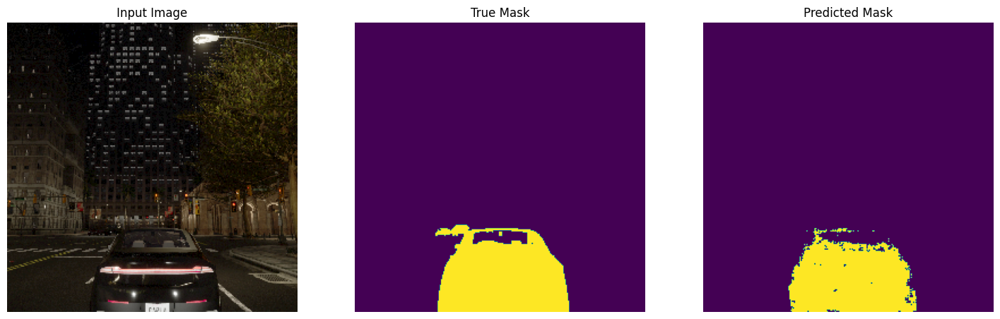

1/1 [==============================] - 0s 112ms/step


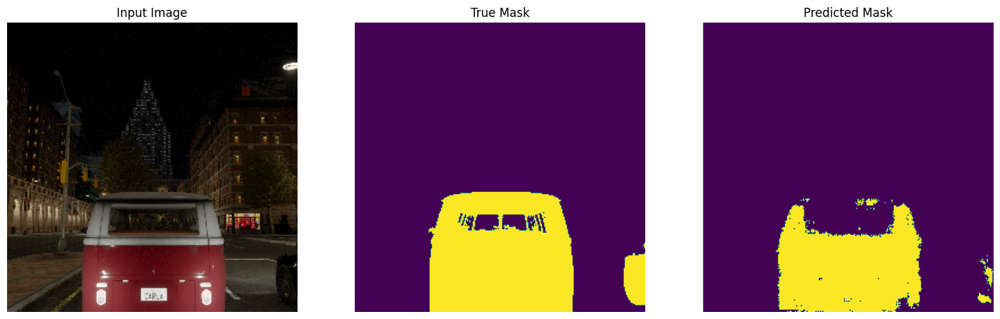

1/1 [==============================] - 0s 113ms/step


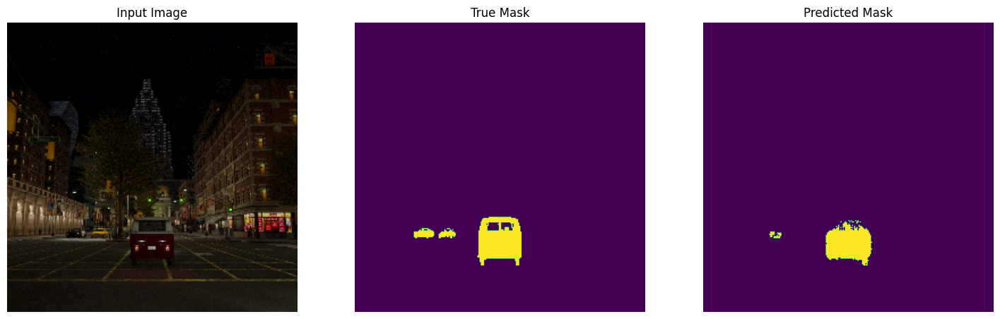

1/1 [==============================] - 0s 113ms/step


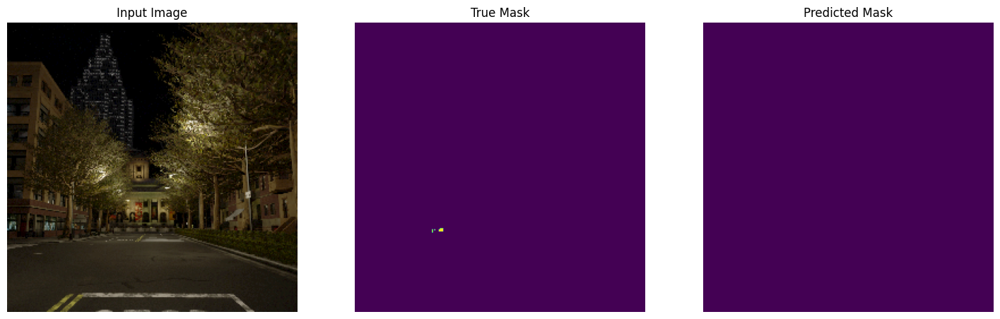

1/1 [==============================] - 0s 128ms/step


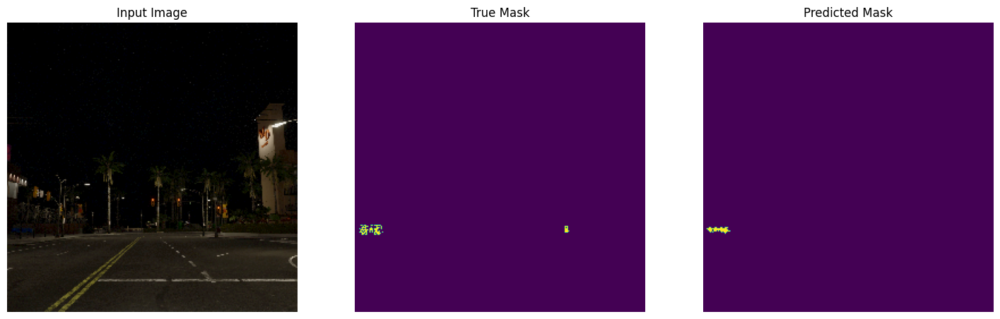

1/1 [==============================] - 0s 121ms/step


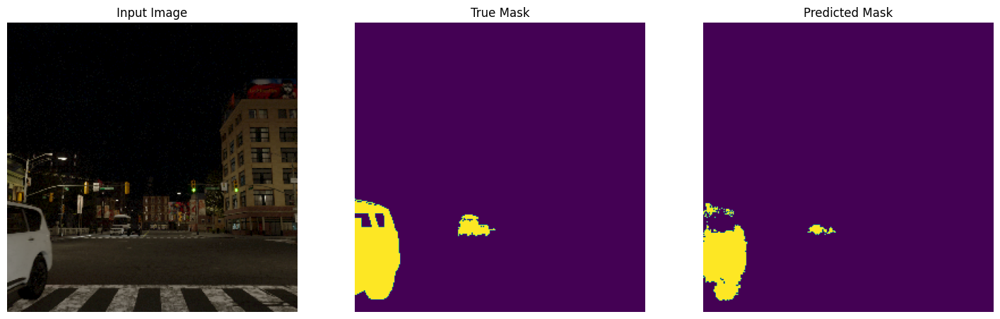

1/1 [==============================] - 0s 116ms/step


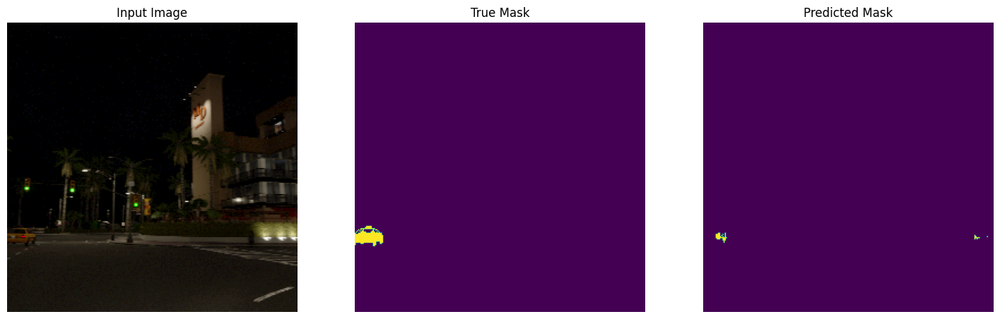

1/1 [==============================] - 0s 128ms/step


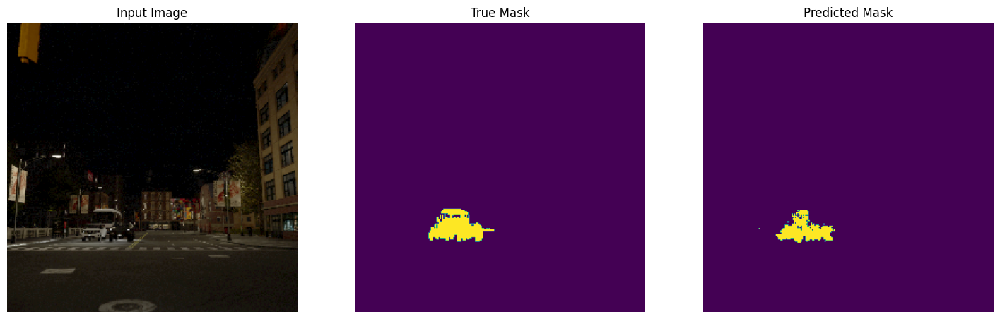

In [18]:
def show_predictions(dataset, num):
    """
    Displays the first image of each of the num batches
    """
    if dataset:
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            display([image[0], mask[0], create_mask(pred_mask)])
    else:
        display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))])

show_predictions(testDataset,100)